In [ ]:
#ID1： 24110908  ID2： 24026719
#The code can execute without error
#https://github.com/lavendelion/YOLOv1-from-scratch

In [ ]:
pip install torchvision

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 20.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 11.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 13.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 81.5 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitlin

In [ ]:
import os
import shutil
import xml.etree.ElementTree as ET
from sklearn.model_selection import train_test_split
from torchvision.datasets import VOCDetection
from google.colab import drive

# Create necessary directory structure
base_dir = "/content/drive/MyDrive"
voc_yolo_dir = os.path.join(base_dir, "VOC_YOLO")
imagenet_dir = os.path.join(base_dir, "ImageNet")
os.makedirs(voc_yolo_dir, exist_ok=True)
os.makedirs(imagenet_dir, exist_ok=True)

# ----------------------------
# Step 1: Download and process the VOC2012 dataset
# ----------------------------
print("Downloading VOC2012 dataset...")
voc_dataset = VOCDetection(
    root=base_dir,
    year="2012",
    image_set="train",
    download=True,  # Automatically download
    transform=None
)

# VOC original paths
voc_root = os.path.join(base_dir, "VOCdevkit/VOC2012")
annotations_dir = os.path.join(voc_root, "Annotations")
images_dir = os.path.join(voc_root, "JPEGImages")

# ----------------------------

In [ ]:
"""
Data preparation: Process the data into two files, one is `train.csv`, and the other is `train.txt`. Similarly, there will be `test.csv` and `test.txt`.
"""
import xml.etree.ElementTree as ET
import numpy as np
import cv2
import random
import os
import time


GL_CLASSES = ['person', 'bird', 'cat', 'cow', 'dog', 'horse', 'sheep',
              'aeroplane', 'bicycle', 'boat', 'bus', 'car', 'motorbike', 'train',
              'bottle', 'chair', 'diningtable', 'pottedplant', 'sofa', 'tvmonitor']
GL_NUMBBOX = 2
GL_NUMGRID = 7
STATIC_DATASET_PATH = r'/content/drive/MyDrive/VOCdevkit/VOC2012'
STATIC_DEBUG = False  # For debugging purposes


def convert(size, box):
    """Convert the format of bbox coordinates from (x1, y1, x2, y2) to (center_x, center_y, width, height),
    and normalize the values."""
    dw = 1. / size[0]
    dh = 1. / size[1]
    x = (box[0] + box[1]) / 2.0
    y = (box[2] + box[3]) / 2.0
    w = box[1] - box[0]
    h = box[3] - box[2]
    x = x * dw
    w = w * dw
    y = y * dh
    h = h * dh
    return (x, y, w, h)


def convert_annotation(anno_dir, image_id, labels_dir):
    """Convert the XML file of image_id into a label file (txt) for object detection.
    The label file contains the object class, bbox coordinates (top-left corner), and bbox width and height.
    Normalize the four values."""
    in_file = open(os.path.join(anno_dir, 'Annotations/%s' % (image_id)))
    image_id = image_id.split('.')[0]
    tree = ET.parse(in_file)
    root = tree.getroot()
    size = root.find('size')
    w = int(size.find('width').text)
    h = int(size.find('height').text)

    for obj in root.iter('object'):
        difficult = obj.find('difficult').text
        cls = obj.find('name').text
        if cls not in GL_CLASSES or int(difficult) == 1:
            continue
        cls_id = GL_CLASSES.index(cls)
        xmlbox = obj.find('bndbox')
        points = (float(xmlbox.find('xmin').text), float(xmlbox.find('xmax').text), float(xmlbox.find('ymin').text),
                  float(xmlbox.find('ymax').text))
        bb = convert((w, h), points)
        with open(os.path.join(labels_dir, '%s.txt' % (image_id)), 'a') as out_file:
            out_file.write(str(cls_id) + " " + " ".join([str(a) for a in bb]) + '\n')


def make_label_txt(anno_dir, labels_dir):
    """Create image_id.txt in the labels folder, extracting bbox information from each image_id.xml."""
    filenames = os.listdir(os.path.join(anno_dir, 'Annotations'))
    for file in filenames:
        convert_annotation(anno_dir, file, labels_dir)


def img_augument(img_dir, save_img_dir, labels_dir):
    """Preprocess images: resize, pad, and adjust bbox coordinates accordingly."""
    imgs_list = [x.split('.')[0] + ".jpg" for x in os.listdir(labels_dir)]
    for img_name in imgs_list:
        print("Processing %s" % os.path.join(img_dir, img_name))
        img = cv2.imread(os.path.join(img_dir, img_name))
        h, w = img.shape[0:2]
        input_size = 448  # Input image size for YOLOv1 network is 448x448
        # Since the original image sizes vary, padding is needed to make the images square.
        # Then, resize the padded square image to 448x448.
        padw, padh = 0, 0  # Record the padding values for width and height, as bbox positions need adjustment after padding.
        if h > w:
            padw = (h - w) // 2
            img = np.pad(img, ((0, 0), (padw, padw), (0, 0)), 'constant', constant_values=0)
        elif w > h:
            padh = (w - h) // 2
            img = np.pad(img, ((padh, padh), (0, 0), (0, 0)), 'constant', constant_values=0)
        img = cv2.resize(img, (input_size, input_size))
        cv2.imwrite(os.path.join(save_img_dir, img_name), img)
        # Read the corresponding bbox information for the image, stored in a 1D format.
        # Every 5 elements represent a bbox (cls, xc, yc, w, h).
        with open(os.path.join(labels_dir, img_name.split('.')[0] + ".txt"), 'r') as f:
            bbox = f.read().split('\n')
        bbox = [x.split() for x in bbox]
        bbox = [float(x) for y in bbox for x in y]
        if len(bbox) % 5 != 0:
            raise ValueError("File:"
                             + os.path.join(labels_dir, img_name.split('.')[0] + ".txt") + "——bbox Extraction Error!")

        # Adjust the original bbox data based on padding and image augmentation.
        if padw != 0:
            for i in range(len(bbox) // 5):
                bbox[i * 5 + 1] = (bbox[i * 5 + 1] * w + padw) / h
                bbox[i * 5 + 3] = (bbox[i * 5 + 3] * w) / h
                if STATIC_DEBUG:
                    cv2.rectangle(img, (int(bbox[1] * input_size - bbox[3] * input_size / 2),
                                        int(bbox[2] * input_size - bbox[4] * input_size / 2)),
                                  (int(bbox[1] * input_size + bbox[3] * input_size / 2),
                                   int(bbox[2] * input_size + bbox[4] * input_size / 2)), (0, 0, 255))
        elif padh != 0:
            for i in range(len(bbox) // 5):
                bbox[i * 5 + 2] = (bbox[i * 5 + 2] * h + padh) / w
                bbox[i * 5 + 4] = (bbox[i * 5 + 4] * h) / w
                if STATIC_DEBUG:
                    cv2.rectangle(img, (int(bbox[1] * input_size - bbox[3] * input_size / 2),
                                        int(bbox[2] * input_size - bbox[4] * input_size / 2)),
                                  (int(bbox[1] * input_size + bbox[3] * input_size / 2),
                                   int(bbox[2] * input_size + bbox[4] * input_size / 2)), (0, 0, 255))
        # Optionally, add code here to verify the modified bbox values after padding by drawing bbox on the original image.
        if STATIC_DEBUG:
            cv2.imshow("bbox-%d" % int(bbox[0]), img)
            cv2.waitKey(0)
        with open(os.path.join(labels_dir, img_name.split('.')[0] + ".txt"), 'w') as f:
            for i in range(len(bbox) // 5):
                bbox = [str(x) for x in bbox[i * 5:(i * 5 + 5)]]
                str_context = " ".join(bbox) + '\n'
                f.write(str_context)


def convert_bbox2labels(bbox):
    """Convert bbox data (cls, x, y, w, h) into a format convenient for calculating Loss during training (7,7,5*B+cls_num).
    Note: The input bbox information is in (xc, yc, w, h) format, and after conversion, it becomes (px, py, w, h) format."""
    gridsize = 1.0 / GL_NUMGRID
    labels = np.zeros((7, 7, 5 * GL_NUMBBOX + len(GL_CLASSES)))  # Note: Modify this based on the number of classes in the dataset.
    for i in range(len(bbox) // 5):
        gridx = int(bbox[i * 5 + 1] // gridsize)  # The current bbox center falls in the gridx-th grid (column).
        gridy = int(bbox[i * 5 + 2] // gridsize)  # The current bbox center falls in the gridy-th grid (row).
        # (bbox center coordinates - grid top-left corner coordinates) / grid size ==> Relative position of the bbox center.
        gridpx = bbox[i * 5 + 1] / gridsize - gridx
        gridpy = bbox[i * 5 + 2] / gridsize - gridy
        # Set the grid at row gridy, column gridx to be responsible for predicting the current ground truth.
        # Set confidence and corresponding class probability to 1.
        labels[gridy, gridx, 0:5] = np.array([gridpx, gridpy, bbox[i * 5 + 3], bbox[i * 5 + 4], 1])
        labels[gridy, gridx, 5:10] = np.array([gridpx, gridpy, bbox[i * 5 + 3], bbox[i * 5 + 4], 1])
        labels[gridy, gridx, 10 + int(bbox[i * 5])] = 1
    labels = labels.reshape(1, -1)
    return labels


def create_csv_txt(img_dir, anno_dir, save_root_dir, train_val_ratio=0.9, padding=10, debug=False):
    """
    Modification Notes:
    1. Add image file type filtering (only process jpg/jpeg/png)
    2. Use os.path.splitext to correctly handle filenames
    3. Add safety handling for insufficient data
    4. Add label file existence check
    """
    # Create labels directory and generate label files
    labels_dir = os.path.join(anno_dir, "labels")
    if not os.path.exists(labels_dir):
        os.makedirs(labels_dir, exist_ok=True)
        make_label_txt(anno_dir, labels_dir)
        print("Label files generated successfully")

    # Create image save directory and perform image augmentation
    save_img_dir = os.path.join(anno_dir, "voc2012_forYolov1", "img")
    if not os.path.exists(save_img_dir):
        os.makedirs(save_img_dir, exist_ok=True)
        img_augument(img_dir, save_img_dir, labels_dir)
        print("Image augmentation completed")

    # Get all image files (filter non-image files)
    valid_extensions = ('.jpg', '.jpeg', '.png')
    imgs_list = [f for f in os.listdir(save_img_dir)
                if f.lower().endswith(valid_extensions)]

    # Randomly sample 300 images (handle insufficient data safely)
    target_size = 300
    sampled_size = min(target_size, len(imgs_list))
    if len(imgs_list) < target_size:
        print(f"Warning: Only {len(imgs_list)} images available, less than {target_size}. Using all available images.")
    imgs_list = random.sample(imgs_list, sampled_size)
    print(f"Final number of images used: {sampled_size}")

    # Split into training and test sets
    n_trainval = len(imgs_list)
    shuffle_id = list(range(n_trainval))
    random.shuffle(shuffle_id)
    n_train = int(n_trainval * train_val_ratio)
    train_id = shuffle_id[:n_train]
    test_id = shuffle_id[n_train:]

    # Process training set
    train_csv_path = os.path.join(save_root_dir, "train.csv")
    train_txt_path = os.path.join(save_root_dir, "train.txt")
    traincsv = np.zeros((n_train, GL_NUMGRID * GL_NUMGRID * (5 * GL_NUMBBOX + len(GL_CLASSES))), dtype=np.float32)

    with open(train_txt_path, 'w') as traintxt:
        for i, idx in enumerate(train_id):
            img_name = imgs_list[idx]
            base_name = os.path.splitext(img_name)[0]  # Correctly get filename without extension
            img_path = os.path.join(save_img_dir, img_name)

            # Write image path
            traintxt.write(f"{img_path}\n")

            # Process label file
            label_path = os.path.join(labels_dir, f"{base_name}.txt")
            if not os.path.exists(label_path):
                print(f"Warning: Missing label file {label_path}, skipping this sample.")
                continue

            with open(label_path, 'r') as f:
                try:
                    bbox = [float(x) for x in f.read().split()]
                    traincsv[i, :] = convert_bbox2labels(bbox)
                except Exception as e:
                    print(f"Error processing file {label_path}: {str(e)}")
                    continue

    np.savetxt(train_csv_path, traincsv)
    print(f"Successfully created training data: {n_train} samples")

    # Process test set
    test_csv_path = os.path.join(save_root_dir, "test.csv")
    test_txt_path = os.path.join(save_root_dir, "test.txt")
    testcsv = np.zeros((len(test_id), GL_NUMGRID * GL_NUMGRID * (5 * GL_NUMBBOX + len(GL_CLASSES))), dtype=np.float32)

    with open(test_txt_path, 'w') as testtxt:
        for i, idx in enumerate(test_id):
            img_name = imgs_list[idx]
            base_name = os.path.splitext(img_name)[0]
            img_path = os.path.join(save_img_dir, img_name)

            testtxt.write(f"{img_path}\n")

            label_path = os.path.join(labels_dir, f"{base_name}.txt")
            if not os.path.exists(label_path):
                print(f"Warning: Missing label file {label_path}, skipping this sample.")
                continue

            with open(label_path, 'r') as f:
                try:
                    bbox = [float(x) for x in f.read().split()]
                    testcsv[i, :] = convert_bbox2labels(bbox)
                except Exception as e:
                    print(f"Error processing file {label_path}: {str(e)}")
                    continue

    np.savetxt(test_csv_path, testcsv)
    print(f"Successfully created test data: {len(test_id)} samples")


if __name__ == '__main__':
    # Set random seed for reproducibility
    random.seed(0)
    np.random.seed(0)

    # Configure paths
    STATIC_DATASET_PATH = r'/content/drive/MyDrive/VOCdevkit/VOC2012'
    img_dir = os.path.join(STATIC_DATASET_PATH, "JPEGImages")
    save_dir = os.path.join(STATIC_DATASET_PATH, "voc2012_forYolov1")

    # Create output directory
    os.makedirs(save_dir, exist_ok=True)

    # Process dataset
    print("Starting dataset processing...")
    start_time = time.time()

    # Traverse all annotation directories (maintain the original structure, can be modified as needed)
    for anno_dir in [STATIC_DATASET_PATH]:  # Extend if multiple dataset directories need to be processed
        print(f"\nProcessing directory: {anno_dir}")
        create_csv_txt(
            img_dir=img_dir,
            anno_dir=anno_dir,
            save_root_dir=save_dir,
            debug=STATIC_DEBUG
        )

    print(f"\nProcessing completed! Total time: {time.time() - start_time:.2f} seconds")
    print(f"Output directory: {save_dir}")
    print(f"Training files: {len(os.listdir(save_dir))} (should include train.csv and train.txt)")

Starting dataset processing...

Processing directory: /content/drive/MyDrive/VOCdevkit/VOC2012
Final number of images used: 300
Successfully created training data: 270 samples
Successfully created test data: 30 samples

Processing completed! Total time: 0.65 seconds
Output directory: /content/drive/MyDrive/VOCdevkit/VOC2012/voc2012_forYolov1
Training files: 5 (should include train.csv and train.txt)


In [ ]:
"""
This file provides some functional functions/classes required for the project.
"""
import torch
import torch.nn as nn
import numpy as np


class DepthwiseConv(nn.Module):
    """
    Depthwise Separable Convolution Layer
    """
    def __init__(self, in_channels, out_channels, kernel_size, stride, padding=0, bias=True):
        super(DepthwiseConv, self).__init__()
        self.layers = nn.Sequential(
            nn.Conv2d(in_channels=in_channels, out_channels=in_channels, kernel_size=kernel_size, stride=stride,
                      padding=padding, groups=in_channels, bias=bias),
            nn.BatchNorm2d(num_features=in_channels),
            nn.ReLU(),
            nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=1, bias=bias),
            nn.BatchNorm2d(num_features=out_channels),
            nn.ReLU()
        )

    def forward(self, inputs):
        outputs = self.layers(inputs)
        return outputs


class InvertedBottleneck(nn.Module):
    """
    Inverted Bottleneck from MobileNet v2
    """
    def __init__(self, in_channels, out_channels, kernel_size, stride, t_factor, padding=0, bias=True):
        super(InvertedBottleneck, self).__init__()
        mid_channels = t_factor * in_channels
        self.layers = nn.Sequential(
            nn.Conv2d(in_channels=in_channels, out_channels=mid_channels, kernel_size=1, bias=bias),
            nn.BatchNorm2d(num_features=mid_channels),
            nn.ReLU(),
            nn.Conv2d(in_channels=mid_channels, out_channels=mid_channels, kernel_size=kernel_size, stride=stride,
                      padding=padding, bias=bias),
            nn.BatchNorm2d(num_features=mid_channels),
            nn.ReLU(),
            nn.Conv2d(in_channels=mid_channels, out_channels=out_channels, kernel_size=1, bias=bias)
        )

    def forward(self, inputs):
        outputs = self.layers(inputs)
        return outputs


class Flatten(nn.Module):
    """
    A layer to flatten a 3D tensor into a 1D vector
    (n, c, h, w) -> (n, c*h*w)
    """
    def __init__(self):
        super(Flatten, self).__init__()

    def forward(self, x):
        n_samples = x.shape[0]
        x = x.reshape(n_samples, -1)
        return x


def calculate_iou(bbox1, bbox2):
    """
    Calculate IoU (Intersection over Union) between two bounding boxes, bbox1=(x1, y1, x2, y2) and bbox2=(x3, y3, x4, y4).
    """
    if bbox1[2] <= bbox1[0] or bbox1[3] <= bbox1[1] or bbox2[2] <= bbox2[0] or bbox2[3] <= bbox2[1]:
        return 0  # If bbox1 or bbox2 has no area or invalid input, return 0

    intersect_bbox = [0., 0., 0., 0.]  # Intersection region (x1, y1, x2, y2)

    intersect_bbox[0] = max(bbox1[0], bbox2[0])
    intersect_bbox[1] = max(bbox1[1], bbox2[1])
    intersect_bbox[2] = min(bbox1[2], bbox2[2])
    intersect_bbox[3] = min(bbox1[3], bbox2[3])

    w = max(intersect_bbox[2] - intersect_bbox[0], 0)  # Width of intersection
    h = max(intersect_bbox[3] - intersect_bbox[1], 0)  # Height of intersection
    area1 = (bbox1[2] - bbox1[0]) * (bbox1[3] - bbox1[1])  # Area of bbox1
    area2 = (bbox2[2] - bbox2[0]) * (bbox2[3] - bbox2[1])  # Area of bbox2
    area_intersect = w * h  # Area of intersection
    iou = area_intersect / (area1 + area2 - area_intersect + 1e-6)  # IoU, with epsilon to avoid division by zero
    return iou


# Note: Check the format of the input data, whether it is xywh or xyxy
def labels2bbox(matrix):
    """
    Convert the network output (7x7x30) into bbox format (98, 25), then apply NMS to filter results.
    :param matrix: The input data contains bbox coordinates in (px, py, w, h) format, which need to be converted to (x1, y1, x2, y2) for NMS.
    :return: NMS-filtered results, bboxes.shape = (-1, 6), where 0:4 are (x1, y1, x2, y2), 4 is confidence, and 5 is class.
    """
    if matrix.size()[0:2] != (7, 7):
        raise ValueError("Error: Wrong labels size: ", matrix.size(), " != (7,7)")
    matrix = matrix.numpy()
    bboxes = np.zeros((98, 6))
    # Convert 7x7x30 data into bbox format (98, 25), where bbox coordinates are transformed from (px, py, w, h) to (x1, y1, x2, y2) for IoU calculation.
    matrix = matrix.reshape(49, -1)
    bbox = matrix[:, :10].reshape(98, 5)
    r_grid = np.array(list(range(7)))
    r_grid = np.repeat(r_grid, repeats=14, axis=0)  # [0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 ...]
    c_grid = np.array(list(range(7)))
    c_grid = np.repeat(c_grid, repeats=2, axis=0)[np.newaxis, :]
    c_grid = np.repeat(c_grid, repeats=7, axis=0).reshape(-1)  # [0 0 1 1 2 2 3 3 4 4 5 5 6 6 0 0 1 1 2 2 3 3 4 4 5 5 6 6...]
    bboxes[:, 0] = np.maximum((bbox[:, 0] + c_grid) / 7.0 - bbox[:, 2] / 2.0, 0)
    bboxes[:, 1] = np.maximum((bbox[:, 1] + r_grid) / 7.0 - bbox[:, 3] / 2.0, 0)
    bboxes[:, 2] = np.minimum((bbox[:, 0] + c_grid) / 7.0 + bbox[:, 2] / 2.0, 1)
    bboxes[:, 3] = np.minimum((bbox[:, 1] + r_grid) / 7.0 + bbox[:, 3] / 2.0, 1)
    bboxes[:, 4] = bbox[:, 4]
    cls = np.argmax(matrix[:, 10:], axis=1)
    cls = np.repeat(cls, repeats=2, axis=0)
    bboxes[:, 5] = cls
    # Apply NMS to all 98 bboxes to filter out low-confidence and overlapping bboxes.
    keepid = nms_multi_cls(bboxes, thresh=0.1, n_cls=20)
    ids = []
    for x in keepid:
        ids = ids + list(x)
    ids = sorted(ids)
    return bboxes[ids, :]


def nms_1cls(dets, thresh):
    """
    Single-class NMS (Non-Maximum Suppression).
    :param dets: ndarray, nx5, where dets[i, 0:4] are bbox coordinates and dets[i, 4] is the confidence score.
    :param thresh: IoU threshold for NMS.
    """
    # Extract x1, y1, x2, y2, and scores from dets
    x1 = dets[:, 0]
    y1 = dets[:, 1]
    x2 = dets[:, 2]
    y2 = dets[:, 3]
    scores = dets[:, 4]

    # Calculate the area of each bbox
    areas = (x2 - x1 + 1) * (y2 - y1 + 1)
    # Sort indices by confidence score in descending order
    order = scores.argsort()[::-1]

    # List to store the indices of kept bboxes
    keep = []
    while order.size > 0:
        # Index of the bbox with the highest confidence
        i = order[0]
        # Add the index of the highest confidence bbox to keep
        keep.append(i)
        # Calculate the intersection coordinates between the current bbox and the remaining bboxes
        xx1 = np.maximum(x1[i], x1[order[1:]])
        yy1 = np.maximum(y1[i], y1[order[1:]])
        xx2 = np.minimum(x2[i], x2[order[1:]])
        yy2 = np.minimum(y2[i], y2[order[1:]])

        # Calculate the intersection area
        w = np.maximum(0.0, xx2 - xx1 + 1)
        h = np.maximum(0.0, yy2 - yy1 + 1)
        inter = w * h
        # Calculate IoU: intersection area / (area1 + area2 - intersection area)
        iou = inter / (areas[i] + areas[order[1:]] - inter)
        # Keep bboxes with IoU below the threshold
        inds = np.where(iou <= thresh)[0]
        order = order[inds + 1]
    return keep


def nms_multi_cls(dets, thresh, n_cls):
    """
    Multi-class NMS (Non-Maximum Suppression).
    :param dets: ndarray, nx6, where dets[i, 0:4] are bbox coordinates, dets[i, 4] is confidence score, and dets[i, 5] is class index.
    :param thresh: IoU threshold for NMS.
    :param n_cls: Total number of classes.
    """
    # List to store the indices of kept bboxes for each class
    keeps_index = []
    for i in range(n_cls):
        order_i = np.where(dets[:, 5] == i)[0]  # Indices of bboxes for class i
        det = dets[dets[:, 5] == i, 0:5]  # Filter bboxes for class i
        if det.shape[0] == 0:
            keeps_index.append([])
            continue
        keep = nms_1cls(det, thresh)  # Apply NMS for class i
        keeps_index.append(order_i[keep])  # Store kept indices
    return keeps_index


if __name__ == '__main__':
    a = torch.randn((7, 7, 30))  # Random input tensor
    print(a)
    labels2bbox(a)  # Convert to bbox format and apply NMS

tensor([[[ 2.1098e-01, -3.0196e-01, -1.3432e+00,  ...,  2.3172e-01,
           1.8526e+00,  1.9120e-01],
         [ 1.7127e+00, -9.7248e-01,  1.1804e-01,  ..., -1.1507e+00,
           3.2086e-01,  5.7501e-01],
         [-1.2362e-01,  3.4701e-01,  1.6681e+00,  ..., -6.3361e-01,
          -1.9884e+00, -2.2439e-01],
         ...,
         [-1.2475e+00, -6.7768e-01,  1.4187e+00,  ...,  1.0190e+00,
           1.2069e+00, -5.2707e-01],
         [ 6.5607e-01,  6.7923e-01,  3.9307e-01,  ..., -1.5759e+00,
           1.9252e+00,  9.1227e-01],
         [-9.7165e-01, -1.0463e+00, -3.6081e-01,  ..., -1.1759e-01,
           9.9543e-02,  1.4695e+00]],

        [[-1.2855e+00,  2.6309e-01, -4.0405e-01,  ..., -1.8977e+00,
          -6.2461e-01, -1.3034e-01],
         [-6.6865e-01,  5.6439e-01,  1.6939e+00,  ...,  8.1550e-01,
           7.3813e-01, -8.9520e-01],
         [-7.0071e-01, -2.1039e-01, -2.8867e-01,  ..., -1.1758e+00,
           1.4595e+00, -6.7989e-01],
         ...,
         [-1.2245e+00, -9

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as tvmodel


class MyNet(nn.Module):
    """
    YOLOv1 network, based on ResNet18 backbone.
    """
    def __init__(self):
        super(MyNet, self).__init__()
        # Use ResNet18 as backbone
        resnet = tvmodel.resnet18(pretrained=True)
        resnet_out_channel = resnet.fc.in_features  # Output channels of ResNet18, should be 512
        self.resnet = nn.Sequential(*list(resnet.children())[:-2])  # Remove the last two layers

        # YOLOv1 convolutional layers
        self.Conv_layers = nn.Sequential(
            nn.Conv2d(resnet_out_channel, 64, 3, padding=1),  # Input channels is resnet_out_channel (512)
            nn.BatchNorm2d(64),
            nn.LeakyReLU(inplace=True),
            nn.Conv2d(64, 64, 3, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(inplace=True),
            nn.Conv2d(64, 64, 3, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(inplace=True),
            nn.Conv2d(64, 128, 3, padding=1),  # Output channels is 128, matching the fully connected layers
            nn.BatchNorm2d(128),
            nn.LeakyReLU(inplace=True),
        )

        # YOLOv1 fully connected layers
        self.Conn_layers = nn.Sequential(
            nn.Linear(GL_NUMGRID * GL_NUMGRID * 128, 4096),  # Input dimension matches the output of convolutional layers
            nn.LeakyReLU(inplace=True),
            nn.Linear(4096, GL_NUMGRID * GL_NUMGRID * (5 * GL_NUMBBOX + len(GL_CLASSES))),
            nn.Sigmoid()
        )

    def forward(self, inputs):
        # Forward propagation
        x = self.resnet(inputs)  # ResNet18 backbone
        x = self.Conv_layers(x)  # YOLOv1 convolutional layers
        x = x.view(x.size()[0], -1)  # Flatten
        x = self.Conn_layers(x)  # Fully connected layers
        self.pred = x.reshape(-1, (5 * GL_NUMBBOX + len(GL_CLASSES)), GL_NUMGRID, GL_NUMGRID)  # Reshape
        return self.pred

    def calculate_loss(self, labels):
        # Calculate loss
        self.pred = self.pred.double()
        labels = labels.double()
        num_gridx, num_gridy = GL_NUMGRID, GL_NUMGRID
        noobj_confi_loss = 0.
        coor_loss = 0.
        obj_confi_loss = 0.
        class_loss = 0.
        n_batch = labels.size()[0]

        for i in range(n_batch):
            for n in range(num_gridx):
                for m in range(num_gridy):
                    if labels[i, 4, m, n] == 1:  # If it contains an object
                        # Convert data (px, py, w, h) to (x1, y1, x2, y2)
                        bbox1_pred_xyxy = (
                            (self.pred[i, 0, m, n] + n) / num_gridx - self.pred[i, 2, m, n] / 2,
                            (self.pred[i, 1, m, n] + m) / num_gridy - self.pred[i, 3, m, n] / 2,
                            (self.pred[i, 0, m, n] + n) / num_gridx + self.pred[i, 2, m, n] / 2,
                            (self.pred[i, 1, m, n] + m) / num_gridy + self.pred[i, 3, m, n] / 2
                        )
                        bbox2_pred_xyxy = (
                            (self.pred[i, 5, m, n] + n) / num_gridx - self.pred[i, 7, m, n] / 2,
                            (self.pred[i, 6, m, n] + m) / num_gridy - self.pred[i, 8, m, n] / 2,
                            (self.pred[i, 5, m, n] + n) / num_gridx + self.pred[i, 7, m, n] / 2,
                            (self.pred[i, 6, m, n] + m) / num_gridy + self.pred[i, 8, m, n] / 2
                        )
                        bbox_gt_xyxy = (
                            (labels[i, 0, m, n] + n) / num_gridx - labels[i, 2, m, n] / 2,
                            (labels[i, 1, m, n] + m) / num_gridy - labels[i, 3, m, n] / 2,
                            (labels[i, 0, m, n] + n) / num_gridx + labels[i, 2, m, n] / 2,
                            (labels[i, 1, m, n] + m) / num_gridy + labels[i, 3, m, n] / 2
                        )
                        iou1 = calculate_iou(bbox1_pred_xyxy, bbox_gt_xyxy)
                        iou2 = calculate_iou(bbox2_pred_xyxy, bbox_gt_xyxy)

                        if iou1 >= iou2:
                            coor_loss = coor_loss + 5 * (torch.sum((self.pred[i, 0:2, m, n] - labels[i, 0:2, m, n]) ** 2) \
                                        + torch.sum((self.pred[i, 2:4, m, n].sqrt() - labels[i, 2:4, m, n].sqrt()) ** 2))
                            obj_confi_loss = obj_confi_loss + (self.pred[i, 4, m, n] - iou1) ** 2
                            noobj_confi_loss = noobj_confi_loss + 0.5 * ((self.pred[i, 9, m, n] - iou2) ** 2)
                        else:
                            coor_loss = coor_loss + 5 * (torch.sum((self.pred[i, 5:7, m, n] - labels[i, 5:7, m, n]) ** 2) \
                                        + torch.sum((self.pred[i, 7:9, m, n].sqrt() - labels[i, 7:9, m, n].sqrt()) ** 2))
                            obj_confi_loss = obj_confi_loss + (self.pred[i, 9, m, n] - iou2) ** 2
                            noobj_confi_loss = noobj_confi_loss + 0.5 * ((self.pred[i, 4, m, n] - iou1) ** 2)

                        # Check if the class label is valid
                        if labels[i, 10:, m, n].shape[0] > 0:
                            class_loss = class_loss + torch.sum((self.pred[i, 10:, m, n] - labels[i, 10:, m, n]) ** 2)
                    else:
                        noobj_confi_loss = noobj_confi_loss + 0.5 * torch.sum(self.pred[i, [4, 9], m, n] ** 2)

        loss = coor_loss + obj_confi_loss + noobj_confi_loss + class_loss
        return loss / n_batch


if __name__ == '__main__':
    # Custom input tensor to verify the network can run and calculate loss, for debugging
    x = torch.zeros(5, 3, 448, 448)  # Input image size is 448x448
    net = MyNet()
    a = net(x)
    labels = torch.zeros(5, 30, 7, 7)  # Label shape is [batch_size, 30, 7, 7]
    loss = net.calculate_loss(labels)
    print("Loss:", loss)
    print("Output shape:", a.shape)

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loss: tensor(12.5929, dtype=torch.float64, grad_fn=<DivBackward0>)
Output shape: torch.Size([5, 30, 7, 7])


In [ ]:
class MyDataset(Dataset):
    def __init__(self, dataset_dir, seed=None, mode="train", train_val_ratio=0.9, trans=None):
        """
        dataset_dir: Folder where the dataset is stored
        seed: Random seed for shuffling data
        mode: Data mode, "train", "val", "test"
        train_val_ratio: The ratio of training to validation set when in training mode
        trans: Data preprocessing function

        """
        if seed is None:
            seed = random.randint(0, 65536)
        random.seed(seed)
        self.dataset_dir = dataset_dir
        self.mode = mode
        if mode=="val":
            mode = "train"
        img_list_txt = os.path.join(dataset_dir, mode+".txt")  # File that stores the image paths
        label_csv = os.path.join(dataset_dir, mode+".csv")  # File that stores the labels
        self.img_list = []
        self.label = np.loadtxt(label_csv)  # Read label array file
        # Read image path file
        with open(img_list_txt, 'r') as f:
            for line in f.readlines():
                self.img_list.append(line.strip())
        # Split the data when mode="train" or "val"
        # Note that the seed passed in mode="val" must be the same as for mode="train"
        self.num_all_data = len(self.img_list)
        all_ids = list(range(self.num_all_data))
        num_train = int(train_val_ratio*self.num_all_data)
        if self.mode == "train":
            self.use_ids = all_ids[:num_train]
        elif self.mode == "val":
            self.use_ids = all_ids[num_train:]
        else:
            self.use_ids = all_ids

        # Store data augmentation function
        self.trans = trans

    def __len__(self):
        """Get the number of samples in the dataset"""
        return len(self.use_ids)

    def __getitem__(self, item):
        """
        1. Sequentially get the item-th training data img and its corresponding label
        2. Preprocess the image data and finally convert it to (c, h, w) dimensions, converting it to a torch.tensor
        3. Convert the sample label to the specified format of torch.tensor as needed
        """
        id = self.use_ids[item]
        label = torch.tensor(self.label[id, :])
        img_path = self.img_list[id]
        img = Image.open(img_path)
        if self.trans is None:
            trans = transforms.Compose([
                # transforms.Resize((112,112)),
                transforms.ToTensor(),
            ])
        else:
            trans = self.trans
        img = trans(img)  # Image preprocessing & data augmentation
        # transforms.ToPILImage()(img).show()  # for debug
        # print(label)
        return img, label

if __name__ == '__main__':
    # For debugging, sequentially retrieve the data to check if it's correct
    dataset_dir = r"/content/drive/MyDrive/VOCdevkit/VOC2012/voc2012_forYolov1"
    dataset = MyDataset(dataset_dir)
    dataloader = DataLoader(dataset, 1)
#    for i in enumerate(dataloader):
#        input("press enter to continue")


In [ ]:
import argparse
import torch
import os

class Args(object):
    """
    Interface for setting command-line arguments
    """
    def __init__(self):
        self.parser = argparse.ArgumentParser()
        self.opts = None

    def set_train_args(self):
        """Options for training"""
        # Manually set training parameters
        self.opts = argparse.Namespace(
            batch_size=32,
            lr=0.001,
            weight_decay=1e-4,
            epoch=24,
            start_epoch=20,
            use_GPU=torch.cuda.is_available(),
            GPU_id=torch.cuda.current_device() if torch.cuda.is_available() else None,
            dataset_dir=r"/content/drive/MyDrive/VOCdevkit/VOC2012/voc2012_forYolov1",  # Dataset path
            checkpoints_dir="/content/checkpoints",  # Model weight save path
            print_freq=20,
            save_freq=1,
            num_workers=4,
            pretrain="/content/checkpoints/epoch19.pkl",
            #pretrain = None ,
            random_seed=0
        )

        # Automatically detect GPU
        if torch.cuda.is_available():
            print("Using GPU %d for training." % (self.opts.GPU_id))
        else:
            print("Using CPU for training.")

        # Create the checkpoints directory if it doesn't exist
        if not os.path.exists(self.opts.checkpoints_dir):
            os.makedirs(self.opts.checkpoints_dir)

    def set_test_args(self):
        """Options for inference"""
        # Manually set testing parameters
        self.opts = argparse.Namespace(
            batch_size=1,
            use_GPU=torch.cuda.is_available(),
            GPU_id=torch.cuda.current_device() if torch.cuda.is_available() else None,
            dataset_dir=r"/content/drive/MyDrive/VOCdevkit/VOC2012/voc2012_forYolov1/img",  # Test dataset path
            weight_path="/content/checkpoints/model.pth"  # Model weight path
        )

        # Automatically detect GPU
        if torch.cuda.is_available():
            print("Using GPU %d for training." % (self.opts.GPU_id))
        else:
            print("Using CPU for training.")

    def get_opts(self):
        return self.opts


In [ ]:
import sys
sys.argv = ['colab_kernel_launcher.py', '--batch_size', '32', '--lr', '0.001']

In [ ]:
import os
import datetime
import time
import torch
from torch.utils.data import DataLoader

class TrainInterface(object):
    """
    Network training interface.
    __train(): Training process function.
    __validate(): Validation process function.
    __save_model(): Model saving function.
    main(): Main training function.
    """
    def __init__(self, opts):
        """
        :param opts: Command line arguments.
        """
        self.opts = opts
        print("=======================Start training.=======================")

    @staticmethod
    def __train(model, train_loader, optimizer, epoch, num_train, opts):
        model.train()
        device = opts.GPU_id
        avg_metric = 0.
        avg_loss = 0.
        log_file = open(os.path.join(opts.checkpoints_dir, "log.txt"), "a+")
        localtime = datetime.datetime.now().strftime("%Y-%m-%d %H:%M:%S")
        log_file.write(localtime)
        log_file.write("\n======================training epoch %d======================\n" % epoch)

        for i, (imgs, labels) in enumerate(train_loader):
            # Get the current batch size.
            current_batch_size = imgs.size(0)

            # Print the actual shape of labels.
            print("Labels shape:", labels.shape)  # Should be [batch_size, 1470]

            # Reshape labels from [batch_size, 1470] to [batch_size, 30, 7, 7].
            labels = labels.view(current_batch_size, 30, 7, 7)

            # Adjust the permute operation.
            labels = labels.permute(0, 2, 3, 1)  # Change from [batch_size, 30, 7, 7] to [batch_size, 7, 7, 30]

            if opts.use_GPU:
                imgs = imgs.to(device)
                labels = labels.to(device)

            preds = model(imgs)
            loss = model.calculate_loss(labels)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            avg_loss = (avg_loss * i + loss.item()) / (i + 1)

            if i % opts.print_freq == 0:
                print("Epoch %d/%d | Iter %d/%d | training loss = %.3f, avg_loss = %.3f" %
                      (epoch, opts.epoch, i, num_train // opts.batch_size, loss.item(), avg_loss))
                log_file.write("Epoch %d/%d | Iter %d/%d | training loss = %.3f, avg_loss = %.3f\n" %
                              (epoch, opts.epoch, i, num_train // opts.batch_size, loss.item(), avg_loss))
                log_file.flush()

        log_file.close()

    @staticmethod
    def __validate(model, val_loader, epoch, num_val, opts):
        """
        Complete validation task after each epoch of training.
        :param model: torch.nn.Module, the network to train.
        :param _loader: torch.utils.data.Dataset, the class corresponding to the validation dataset.
        :param epoch: int, indicating the current epoch being trained.
        :param num_val: int, number of validation samples.
        :param opts: Command line arguments.
        """
        model.eval()
        log_file = open(os.path.join(opts.checkpoints_dir, "log.txt"), "a+")
        log_file.write("======================validate epoch %d======================\n" % epoch)
        preds = None
        gts = None
        avg_metric = 0.
        with torch.no_grad():  # Using this reduces memory usage during validation and improves GPU memory utilization.
            for i, (imgs, labels) in enumerate(val_loader):
                if opts.use_GPU:
                    imgs = imgs.to(opts.GPU_id)
                pred = model(imgs).cpu().squeeze(dim=0).permute(1, 2, 0)
                pred_bbox = labels2bbox(pred)  # Convert network output to bbox with shape (-1, 6) after NMS.
            metric = model.calculate_metric(preds, gts)
            print("Evaluation of validation result: average L2 distance = %.5f" % (metric))
            log_file.write("Evaluation of validation result: average L2 distance = %.5f\n" % (metric))
            log_file.flush()
            log_file.close()
        return metric

    @staticmethod
    def __save_model(model, epoch, opts):
        """
        Save the model parameters for the specified epoch.
        :param model: torch.nn.Module, the network to train.
        :param epoch: int, indicating the current epoch being trained.
        :param opts: Command line arguments.
        """
        model_name = "epoch%d.pkl" % epoch
        save_dir = os.path.join(opts.checkpoints_dir, model_name)
        torch.save(model, save_dir)

    def main(self):
        """
        Main training function, completes the entire training process.
        1. Create DataLoader classes for training and validation datasets.
        2. Initialize the network for training.
        3. Select the appropriate optimizer.
        4. Train and validate for the specified number of epochs, saving the model with the best evaluation metric.
        5. TODO: Visualize training process information.
        """
        opts = self.opts
        if not os.path.exists(opts.checkpoints_dir):
            os.mkdir(opts.checkpoints_dir)
        random_seed = opts.random_seed
        train_dataset = MyDataset(opts.dataset_dir, seed=random_seed, mode="train", train_val_ratio=0.9)
        val_dataset = MyDataset(opts.dataset_dir, seed=random_seed, mode="val", train_val_ratio=0.9)
        train_loader = DataLoader(train_dataset, opts.batch_size, shuffle=True, num_workers=opts.num_workers)
        val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False, num_workers=opts.num_workers)
        num_train = len(train_dataset)
        num_val = len(val_dataset)

        if opts.pretrain is None:
            model = MyNet()
        else:
            model = torch.load('/content/checkpoints/epoch19.pkl', weights_only=False)
        if opts.use_GPU:
            model.to(opts.GPU_id)
        optimizer = torch.optim.SGD(model.parameters(), lr=opts.lr, momentum=0.9, weight_decay=opts.weight_decay)
        # optimizer = torch.optim.Adam(model.parameters(), lr=opts.lr, weight_decay=opts.weight_decay)

        best_metric = 1000000
        for e in range(opts.start_epoch, opts.epoch + 1):
            t = time.time()
            self.__train(model, train_loader, optimizer, e, num_train, opts)
            t2 = time.time()
            print("Training consumes %.2f second\n" % (t2 - t))
            with open(os.path.join(opts.checkpoints_dir, "log.txt"), "a+") as log_file:
                log_file.write("Training consumes %.2f second\n" % (t2 - t))
            if e % opts.save_freq == 0 or e == opts.epoch + 1:
                self.__save_model(model, e, opts)


if __name__ == '__main__':
    # Network training code
    args = Args()
    args.set_train_args()  # Get command line arguments
    train_interface = TrainInterface(args.get_opts())
    train_interface.main()  # Call training interface



use CPU to train.
=======================Start training.=======================


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:624: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Labels shape: torch.Size([32, 1470])
Epoch 20/24 | Iter 0/7 | training loss = 2.455, avg_loss = 2.455
Labels shape: torch.Size([32, 1470])
Labels shape: torch.Size([32, 1470])
Labels shape: torch.Size([32, 1470])
Labels shape: torch.Size([32, 1470])
Labels shape: torch.Size([32, 1470])
Labels shape: torch.Size([32, 1470])
Labels shape: torch.Size([19, 1470])
Training consumes 311.34 second

Labels shape: torch.Size([32, 1470])
Epoch 21/24 | Iter 0/7 | training loss = 0.424, avg_loss = 0.424
Labels shape: torch.Size([32, 1470])
Labels shape: torch.Size([32, 1470])
Labels shape: torch.Size([32, 1470])
Labels shape: torch.Size([32, 1470])
Labels shape: torch.Size([32, 1470])
Labels shape: torch.Size([32, 1470])
Labels shape: torch.Size([19, 1470])
Training consumes 321.91 second

Labels shape: torch.Size([32, 1470])
Epoch 22/24 | Iter 0/7 | training loss = 0.031, avg_loss = 0.031
Labels shape: torch.Size([32, 1470])
Labels shape: torch.Size([32, 1470])
Labels shape: torch.Size([32, 1470])

use CPU to train.
=======================Start inferring.=======================
2008_001638.jpg torch.Size([1, 3, 448, 448])
Number of bounding boxes: 18
BBox values: [[ 0.10406434  0.          0.60720175  0.34981907  0.11479776  1.        ]
 [ 0.36028322  0.          0.90916273  0.33784184  0.1153306   4.        ]
 [ 0.          0.          0.46329392  0.52514008  0.09184643 10.        ]
 [ 0.1265462   0.          0.59817004  0.48225015  0.11032207 13.        ]
 [ 0.37719226  0.          0.93915731  0.49994445  0.10065036 17.        ]
 [ 0.73993772  0.          1.          0.52210735  0.08939692  7.        ]
 [ 0.54107372  0.03436565  1.          0.69447469  0.12011177  2.        ]
 [ 0.65581061  0.10865945  1.          0.60195929  0.10470362 14.        ]
 [ 0.          0.22344415  0.30939908  0.78182052  0.11036228 18.        ]
 [ 0.          0.26879699  0.46419876  0.71610267  0.08409516  8.        ]
 [ 0.13841285  0.19492071  0.59218146  0.78133093  0.08831299  0.        ]
 [ 0.36

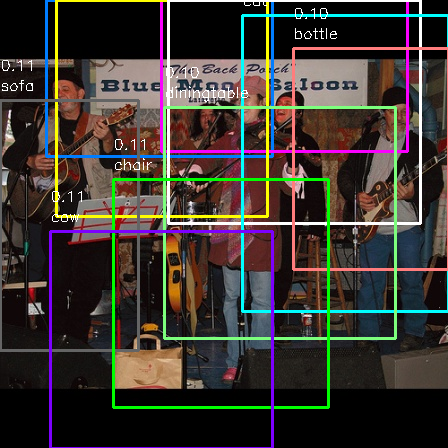

BBox shape: (18, 6)
BBox values: [[ 0.10406434  0.          0.60720175  0.34981907  0.11479776  1.        ]
 [ 0.36028322  0.          0.90916273  0.33784184  0.1153306   4.        ]
 [ 0.          0.          0.46329392  0.52514008  0.09184643 10.        ]
 [ 0.1265462   0.          0.59817004  0.48225015  0.11032207 13.        ]
 [ 0.37719226  0.          0.93915731  0.49994445  0.10065036 17.        ]
 [ 0.73993772  0.          1.          0.52210735  0.08939692  7.        ]
 [ 0.54107372  0.03436565  1.          0.69447469  0.12011177  2.        ]
 [ 0.65581061  0.10865945  1.          0.60195929  0.10470362 14.        ]
 [ 0.          0.22344415  0.30939908  0.78182052  0.11036228 18.        ]
 [ 0.          0.26879699  0.46419876  0.71610267  0.08409516  8.        ]
 [ 0.13841285  0.19492071  0.59218146  0.78133093  0.08831299  0.        ]
 [ 0.36670891  0.23934264  0.88375024  0.75640053  0.10472506 16.        ]
 [ 0.14711029  0.3810287   0.56802065  0.89137553  0.08490234 12.  

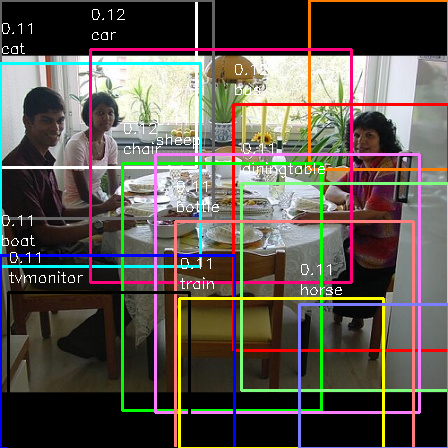

BBox shape: (19, 6)
BBox values: [[0.00000000e+00 0.00000000e+00 4.39378536e-01 3.74199910e-01
  1.14192620e-01 1.70000000e+01]
 [6.91542751e-01 0.00000000e+00 1.00000000e+00 3.78674226e-01
  1.05216645e-01 1.20000000e+01]
 [0.00000000e+00 0.00000000e+00 4.77421539e-01 4.88499152e-01
  1.10559881e-01 1.80000000e+01]
 [0.00000000e+00 1.40990147e-01 4.47548975e-01 5.93863734e-01
  1.11837596e-01 2.00000000e+00]
 [1.15733362e-01 1.23809404e-01 6.04789740e-01 5.72065211e-01
  9.69980955e-02 3.00000000e+00]
 [2.02613192e-01 1.11358247e-01 7.83896165e-01 6.29815957e-01
  1.20388761e-01 1.10000000e+01]
 [0.00000000e+00 2.61139008e-01 4.91045884e-01 7.54244032e-01
  8.63466486e-02 8.00000000e+00]
 [7.96599346e-02 2.46745471e-01 6.40789803e-01 7.61458222e-01
  9.83005986e-02 7.00000000e+00]
 [5.20280634e-01 2.33652779e-01 1.00000000e+00 7.83267447e-01
  1.15563825e-01 1.00000000e+01]
 [0.00000000e+00 4.09490251e-01 4.62559206e-01 9.04512637e-01
  8.12884718e-02 1.00000000e+00]
 [2.74196787e-01 

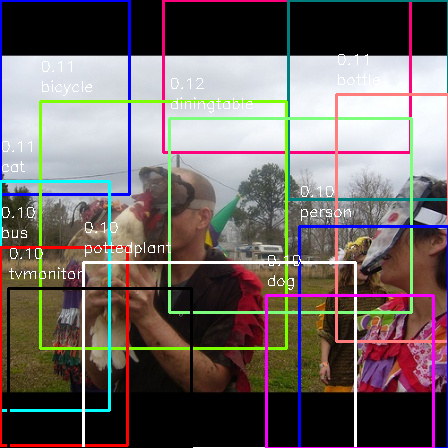

BBox shape: (20, 6)
BBox values: [[ 0.36485176  0.          0.9160866   0.34029033  0.11236723 11.        ]
 [ 0.          0.          0.28940583  0.43311176  0.10282294  9.        ]
 [ 0.64346687  0.          1.          0.44565839  0.10102185  7.        ]
 [ 0.          0.12940115  0.30283846  0.59847042  0.09908024 12.        ]
 [ 0.          0.23464412  0.32303535  0.74822135  0.08063566 18.        ]
 [ 0.09126444  0.22646786  0.64011701  0.77839209  0.10687046  8.        ]
 [ 0.21875067  0.28997104  0.77834345  0.69608237  0.09173732  5.        ]
 [ 0.37935711  0.26488785  0.91816641  0.69862826  0.1245345  16.        ]
 [ 0.51727854  0.2413732   1.          0.77203705  0.09222656 13.        ]
 [ 0.75216795  0.20982214  1.          0.76290508  0.11311372 14.        ]
 [ 0.          0.40536218  0.24334692  0.91528176  0.11145391  2.        ]
 [ 0.          0.36630782  0.45199015  0.92056313  0.09108281  1.        ]
 [ 0.45201434  0.38814876  0.84104748  0.9022244   0.09988181  6.  

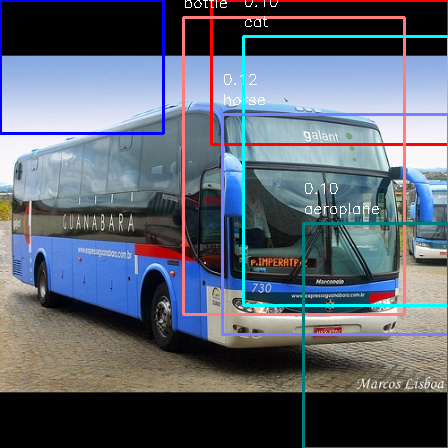

BBox shape: (16, 6)
BBox values: [[0.00000000e+00 0.00000000e+00 3.65846996e-01 2.98254032e-01
  1.08818397e-01 9.00000000e+00]
 [0.00000000e+00 0.00000000e+00 4.42238210e-01 4.05270479e-01
  8.56724009e-02 1.70000000e+01]
 [7.47703825e-02 0.00000000e+00 6.38492337e-01 3.27285877e-01
  9.62489843e-02 1.60000000e+01]
 [3.30030122e-01 0.00000000e+00 9.27577832e-01 3.15654842e-01
  9.61515382e-02 1.10000000e+01]
 [4.72860873e-01 0.00000000e+00 1.00000000e+00 3.23178781e-01
  1.02084607e-01 1.00000000e+01]
 [7.07373547e-01 0.00000000e+00 1.00000000e+00 3.81810686e-01
  9.79720280e-02 1.20000000e+01]
 [0.00000000e+00 1.32457158e-01 4.85425787e-01 5.94230017e-01
  9.86123085e-02 4.00000000e+00]
 [8.18683462e-02 1.16943845e-01 5.90838964e-01 5.89570769e-01
  9.89628956e-02 3.00000000e+00]
 [4.10013580e-01 3.83624051e-02 9.02395123e-01 7.01250515e-01
  1.03214942e-01 1.40000000e+01]
 [5.44409922e-01 8.11745737e-02 1.00000000e+00 6.81488297e-01
  1.00068256e-01 2.00000000e+00]
 [4.97259544e-01 

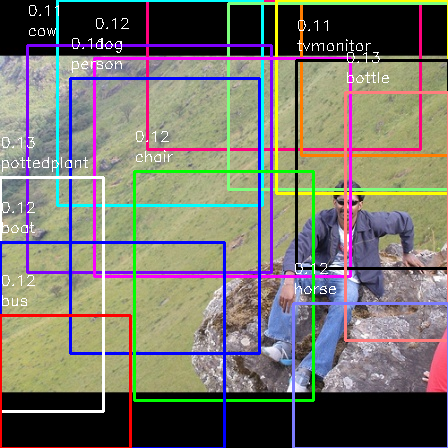

BBox shape: (17, 6)
BBox values: [[3.28245303e-01 0.00000000e+00 9.39461253e-01 3.33905233e-01
  1.07419163e-01 1.10000000e+01]
 [6.72129789e-01 0.00000000e+00 1.00000000e+00 3.46906951e-01
  1.15259394e-01 1.20000000e+01]
 [1.29289110e-01 0.00000000e+00 5.85134138e-01 4.57737901e-01
  1.12214312e-01 2.00000000e+00]
 [5.09039415e-01 8.40884447e-03 1.00000000e+00 4.23739612e-01
  1.26390308e-01 1.60000000e+01]
 [6.17940430e-01 0.00000000e+00 1.00000000e+00 4.32839300e-01
  1.21335089e-01 1.30000000e+01]
 [6.05034573e-02 1.00971886e-01 6.05890427e-01 6.08020672e-01
  1.08171746e-01 3.00000000e+00]
 [2.11459041e-01 1.30111130e-01 7.82054603e-01 6.18041160e-01
  1.16544299e-01 4.00000000e+00]
 [6.62402013e-01 1.34011179e-01 1.00000000e+00 5.99209040e-01
  1.12313919e-01 1.90000000e+01]
 [0.00000000e+00 2.05178022e-01 3.27567688e-01 7.66574502e-01
  9.82597172e-02 1.80000000e+01]
 [0.00000000e+00 2.77145277e-01 4.68949676e-01 7.27738779e-01
  9.03021097e-02 8.00000000e+00]
 [1.57723648e-01 

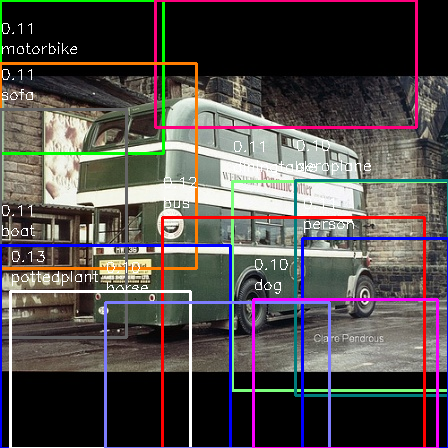

BBox shape: (20, 6)
BBox values: [[ 0.          0.          0.36477435  0.34321672  0.10689917 15.        ]
 [ 0.10486794  0.          0.62203074  0.34759745  0.09256919  6.        ]
 [ 0.34741486  0.          0.92926605  0.28557983  0.10514311 11.        ]
 [ 0.          0.14157359  0.43884626  0.59822843  0.11351869 12.        ]
 [ 0.43313     0.08042659  0.89689395  0.60692026  0.0944589  14.        ]
 [ 0.57278633  0.06458598  1.          0.6900416   0.09559934  2.        ]
 [ 0.64444661  0.11474864  1.          0.61265878  0.09612875 19.        ]
 [ 0.          0.24366641  0.28212957  0.75432109  0.11118866 18.        ]
 [ 0.          0.28148382  0.48480176  0.73696916  0.08752221  8.        ]
 [ 0.          0.36593318  0.46200678  0.92725486  0.08242122  1.        ]
 [ 0.51852609  0.40488451  1.          0.8715215   0.10942464 16.        ]
 [ 0.65998325  0.40358211  1.          0.88193552  0.10208847  7.        ]
 [ 0.          0.54998473  0.25449366  1.          0.09501781 13.  

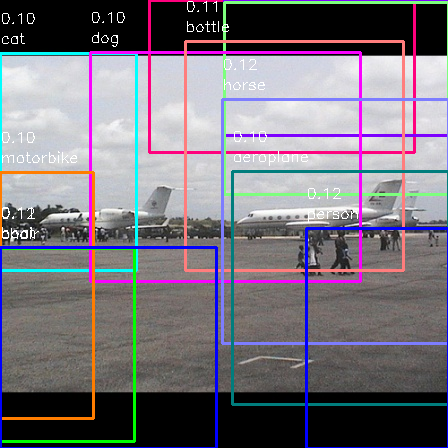

BBox shape: (18, 6)
BBox values: [[3.32650815e-01 0.00000000e+00 9.25477539e-01 3.40850396e-01
  1.09971382e-01 1.10000000e+01]
 [5.01497767e-01 0.00000000e+00 1.00000000e+00 3.02477943e-01
  1.08428396e-01 3.00000000e+00]
 [0.00000000e+00 0.00000000e+00 5.19359082e-01 4.66178373e-01
  9.89792645e-02 1.80000000e+01]
 [3.37956458e-01 0.00000000e+00 9.68632787e-01 4.55850041e-01
  9.83915254e-02 1.70000000e+01]
 [5.00495702e-01 5.04792375e-03 1.00000000e+00 4.35134983e-01
  1.02209933e-01 1.60000000e+01]
 [0.00000000e+00 1.19148465e-01 3.04247413e-01 6.04102792e-01
  1.01655856e-01 2.00000000e+00]
 [2.01481840e-01 1.18088015e-01 8.03798280e-01 6.29401692e-01
  1.01750582e-01 4.00000000e+00]
 [4.13491624e-01 9.24341423e-02 8.99736660e-01 6.03998218e-01
  1.10254250e-01 1.40000000e+01]
 [0.00000000e+00 2.59503343e-01 4.62269038e-01 7.23881879e-01
  9.30624679e-02 8.00000000e+00]
 [4.97587379e-01 2.22716783e-01 1.00000000e+00 7.66373132e-01
  1.22291215e-01 5.00000000e+00]
 [0.00000000e+00 

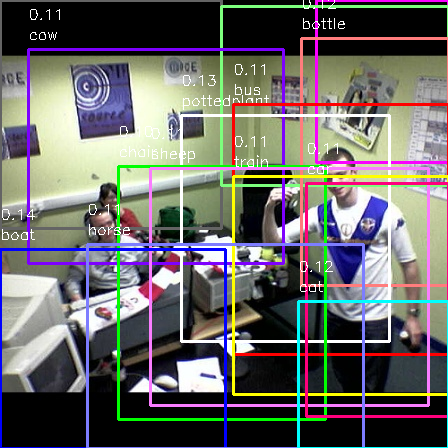

BBox shape: (17, 6)
BBox values: [[7.07014124e-01 0.00000000e+00 1.00000000e+00 3.62699917e-01
  1.00922488e-01 4.00000000e+00]
 [0.00000000e+00 0.00000000e+00 4.94827654e-01 5.11031530e-01
  1.00414895e-01 1.80000000e+01]
 [4.94944062e-01 1.39366942e-02 1.00000000e+00 4.14045508e-01
  1.08285449e-01 1.60000000e+01]
 [6.35958612e-02 1.10288535e-01 6.33636743e-01 5.87580775e-01
  1.11260913e-01 3.00000000e+00]
 [6.73826652e-01 8.49554326e-02 1.00000000e+00 6.37628236e-01
  1.15154885e-01 1.40000000e+01]
 [4.05803504e-01 2.57942936e-01 8.68696900e-01 7.61586866e-01
  1.27736732e-01 1.70000000e+01]
 [5.21297851e-01 2.32211100e-01 1.00000000e+00 7.90454434e-01
  1.11560486e-01 1.00000000e+01]
 [0.00000000e+00 3.88461390e-01 4.58857715e-01 9.20515158e-01
  9.40552652e-02 1.00000000e+00]
 [1.45023951e-01 4.12754687e-01 5.53176829e-01 8.69760158e-01
  8.93956423e-02 1.20000000e+01]
 [2.63529822e-01 3.70593590e-01 7.25529924e-01 9.36655683e-01
  1.04382381e-01 1.50000000e+01]
 [3.35134098e-01 

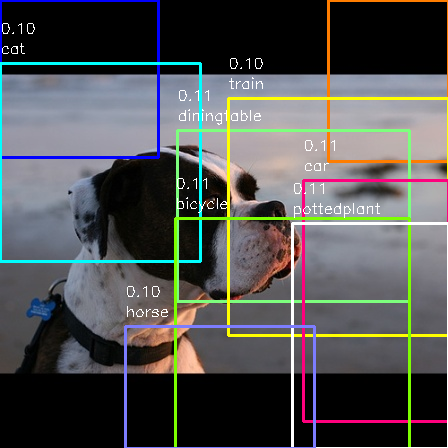

BBox shape: (20, 6)
BBox values: [[ 0.          0.          0.35459943  0.35082815  0.10340882  9.        ]
 [ 0.11227499  0.          0.60782201  0.34286188  0.09159282  6.        ]
 [ 0.27691913  0.          0.72653937  0.38807378  0.09024546  0.        ]
 [ 0.49610264  0.          1.          0.29332802  0.08947502  3.        ]
 [ 0.73326484  0.          1.          0.3596811   0.10324024 12.        ]
 [ 0.          0.          0.28812042  0.46301816  0.0931164   1.        ]
 [ 0.          0.          0.50748714  0.45002814  0.09921293  7.        ]
 [ 0.24993295  0.02759742  0.75853074  0.4281781   0.09628728 15.        ]
 [ 0.          0.14261857  0.44716256  0.58476347  0.10285833  2.        ]
 [ 0.07088693  0.13958289  0.60437329  0.57076826  0.09563497 19.        ]
 [ 0.          0.21476408  0.30062859  0.78894313  0.09024855 18.        ]
 [ 0.39637009  0.29144381  0.91297839  0.67213846  0.10978456 16.        ]
 [ 0.51115397  0.21971845  1.          0.7488833   0.10189407 13.  

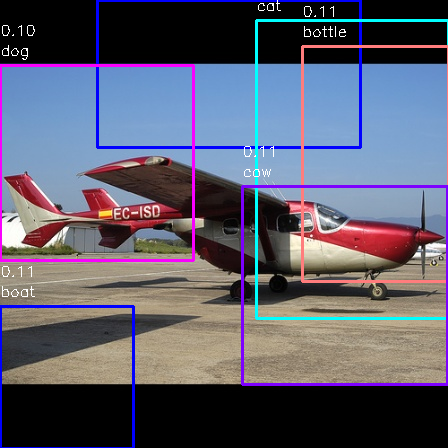

BBox shape: (19, 6)
BBox values: [[ 0.          0.          0.41483599  0.359492    0.09610321 13.        ]
 [ 0.11267423  0.          0.60619055  0.32525811  0.08931032 11.        ]
 [ 0.21769255  0.          0.80480325  0.32895046  0.10104467  0.        ]
 [ 0.          0.          0.29730485  0.41864533  0.09888238 12.        ]
 [ 0.          0.          0.44835493  0.51623668  0.09188467 18.        ]
 [ 0.36451086  0.          0.94819632  0.44768668  0.09822427  5.        ]
 [ 0.61841066  0.          1.          0.43491035  0.09971185  7.        ]
 [ 0.          0.14628144  0.43111108  0.58155231  0.10361017  4.        ]
 [ 0.5730026   0.04534067  1.          0.71197118  0.10038541  2.        ]
 [ 0.67456207  0.10355295  1.          0.62729306  0.1105772  14.        ]
 [ 0.06895796  0.2292299   0.64784101  0.77580157  0.08215546  8.        ]
 [ 0.39455587  0.25353333  0.90338374  0.70899739  0.09817906 16.        ]
 [ 0.          0.38742558  0.47480031  0.89903013  0.09731112  1.  

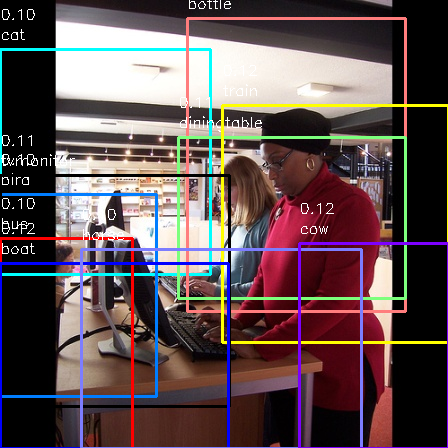

BBox shape: (17, 6)
BBox values: [[ 0.38351419  0.          0.89205506  0.30818881  0.09029458 11.        ]
 [ 0.64859493  0.          1.          0.36418214  0.0890795  12.        ]
 [ 0.40604185  0.          0.9139558   0.51403541  0.08823478 17.        ]
 [ 0.          0.11007259  0.47063463  0.61296353  0.1008986   2.        ]
 [ 0.18224633  0.12280606  0.80631167  0.62137186  0.0990978   4.        ]
 [ 0.41933336  0.04217335  0.90519627  0.6948944   0.1149337  14.        ]
 [ 0.          0.20937871  0.32176771  0.7842344   0.09585933  7.        ]
 [ 0.39935607  0.30726412  0.90557057  0.66554465  0.11164385 16.        ]
 [ 0.49682329  0.23475299  1.          0.76481095  0.12150604 13.        ]
 [ 0.          0.43507643  0.34876154  0.88420336  0.10149598  1.        ]
 [ 0.          0.39151136  0.5132599   0.90846232  0.10595223 19.        ]
 [ 0.28328958  0.38741481  0.69799492  0.89565152  0.09511392 15.        ]
 [ 0.66213436  0.36868453  1.          0.97304547  0.09506713  0.  

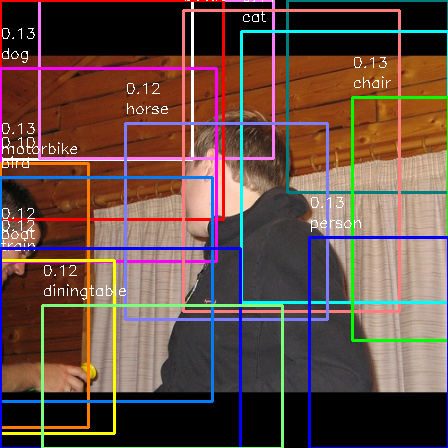

BBox shape: (19, 6)
BBox values: [[ 0.          0.          0.43035353  0.35593058  0.11079087 17.        ]
 [ 0.08799322  0.          0.61107047  0.35312088  0.12399942  6.        ]
 [ 0.38120509  0.          0.89078093  0.33271021  0.09655996 11.        ]
 [ 0.          0.          0.49983911  0.49011141  0.10494491 10.        ]
 [ 0.64091726  0.          1.          0.43034675  0.11544043  7.        ]
 [ 0.          0.153719    0.48318711  0.58341091  0.12586103  4.        ]
 [ 0.1052902   0.13044593  0.61579248  0.58043885  0.08574191  3.        ]
 [ 0.40894322  0.02394604  0.89260815  0.69518894  0.1015765  14.        ]
 [ 0.53895032  0.07082165  1.          0.6762293   0.11242145  2.        ]
 [ 0.          0.25809437  0.29435183  0.72503886  0.09662136 18.        ]
 [ 0.          0.25451753  0.48152495  0.75953487  0.0909412   8.        ]
 [ 0.27994579  0.27594541  0.73173895  0.71240725  0.11592475  5.        ]
 [ 0.78731352  0.2174093   1.          0.75944237  0.13052332 15.  

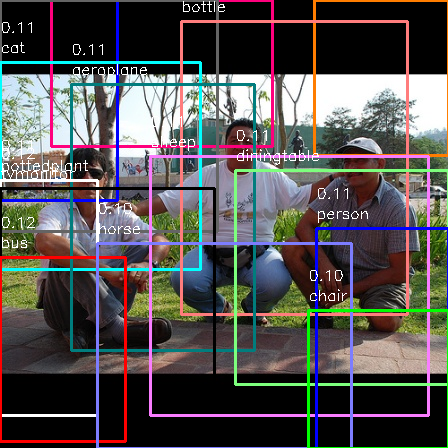

BBox shape: (19, 6)
BBox values: [[ 0.11598468  0.          0.60727412  0.32763601  0.10727555 11.        ]
 [ 0.70301916  0.          1.          0.34704397  0.11572077 12.        ]
 [ 0.          0.          0.26276679  0.44729209  0.10204475  9.        ]
 [ 0.          0.          0.48479654  0.51684025  0.12778559 18.        ]
 [ 0.          0.14023506  0.44708084  0.60066005  0.11410432  2.        ]
 [ 0.06339449  0.11958206  0.61357731  0.58773229  0.09080428  3.        ]
 [ 0.17612119  0.11491343  0.81193228  0.61448874  0.08516248  4.        ]
 [ 0.40491503  0.04790894  0.90933079  0.70297459  0.1138179  14.        ]
 [ 0.          0.3018895   0.49734695  0.70557927  0.08025014  8.        ]
 [ 0.16011055  0.18939629  0.56716373  0.78143504  0.10824514  7.        ]
 [ 0.          0.40206678  0.21870237  0.92836667  0.11222398 17.        ]
 [ 0.          0.42026143  0.4780733   0.89034187  0.11783751 19.        ]
 [ 0.33594852  0.34901249  0.95594692  0.92675536  0.10964336  6.  

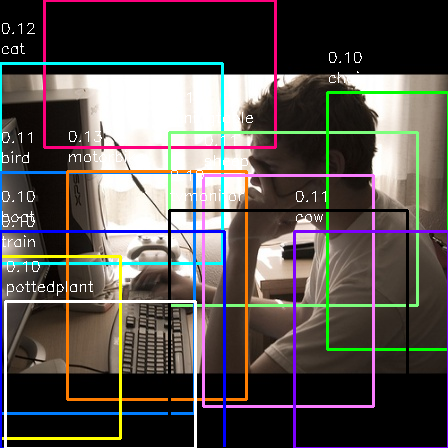

BBox shape: (19, 6)
BBox values: [[0.00000000e+00 0.00000000e+00 4.20978940e-01 3.77398925e-01
  9.96707156e-02 1.80000000e+01]
 [1.00356268e-01 0.00000000e+00 6.15020620e-01 3.29272198e-01
  1.09308444e-01 1.10000000e+01]
 [3.33017741e-01 0.00000000e+00 9.32289813e-01 3.40897309e-01
  8.93735588e-02 8.00000000e+00]
 [0.00000000e+00 0.00000000e+00 4.91986773e-01 4.67387634e-01
  9.99725536e-02 7.00000000e+00]
 [0.00000000e+00 1.41547978e-01 4.96661689e-01 5.87473333e-01
  1.17078565e-01 2.00000000e+00]
 [3.78705123e-01 2.95741154e-01 9.32566085e-01 6.81893063e-01
  1.26480326e-01 1.60000000e+01]
 [5.21780785e-01 2.27848692e-01 1.00000000e+00 7.81587643e-01
  9.82021019e-02 1.00000000e+01]
 [7.29958860e-01 2.07151413e-01 1.00000000e+00 7.80839741e-01
  1.04441039e-01 1.50000000e+01]
 [0.00000000e+00 3.84878725e-01 4.34734583e-01 9.23191220e-01
  1.13029987e-01 1.00000000e+00]
 [1.50272989e-01 3.81724702e-01 5.49409383e-01 8.92787444e-01
  1.26038164e-01 1.20000000e+01]
 [2.62151290e-01 

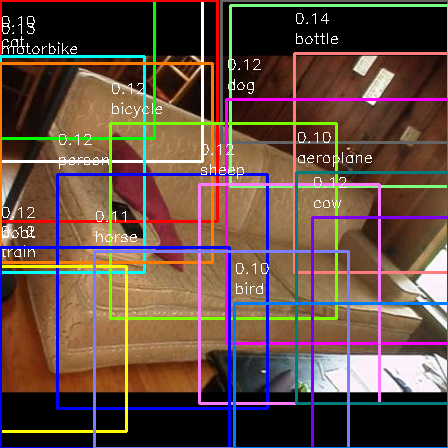

BBox shape: (19, 6)
BBox values: [[0.00000000e+00 0.00000000e+00 3.44186021e-01 3.10012187e-01
  1.06783524e-01 1.50000000e+01]
 [0.00000000e+00 0.00000000e+00 4.51038965e-01 3.59748576e-01
  1.22299477e-01 1.70000000e+01]
 [3.64924861e-01 0.00000000e+00 9.01357485e-01 3.49462266e-01
  9.86483768e-02 1.10000000e+01]
 [4.95290467e-01 0.00000000e+00 1.00000000e+00 3.17401226e-01
  1.26137689e-01 1.80000000e+01]
 [0.00000000e+00 0.00000000e+00 4.84830869e-01 4.93908499e-01
  1.36157542e-01 1.00000000e+01]
 [5.14883693e-01 1.27481605e-02 1.00000000e+00 4.15798643e-01
  1.40458420e-01 1.60000000e+01]
 [0.00000000e+00 1.26599780e-01 3.21648538e-01 6.08126751e-01
  1.04914255e-01 2.00000000e+00]
 [0.00000000e+00 1.42807158e-01 4.74259887e-01 5.85462572e-01
  1.34373933e-01 1.20000000e+01]
 [6.56616569e-01 1.19304691e-01 1.00000000e+00 6.08599101e-01
  1.38595045e-01 1.40000000e+01]
 [2.46120108e-01 2.76730095e-01 7.51296056e-01 7.11467062e-01
  1.15463629e-01 8.00000000e+00]
 [5.06016940e-01 

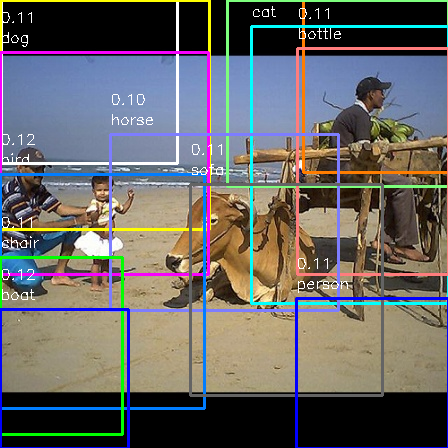

BBox shape: (17, 6)
BBox values: [[4.25236566e-03 0.00000000e+00 3.95806304e-01 3.64065851e-01
  1.08676299e-01 1.70000000e+01]
 [9.60561718e-02 0.00000000e+00 6.20050856e-01 3.53394006e-01
  9.89886969e-02 1.10000000e+01]
 [6.76783411e-01 0.00000000e+00 1.00000000e+00 3.85605799e-01
  1.17111750e-01 1.20000000e+01]
 [0.00000000e+00 0.00000000e+00 4.67772646e-01 5.12611287e-01
  1.02704078e-01 1.30000000e+01]
 [5.08572791e-01 0.00000000e+00 1.00000000e+00 4.16448866e-01
  1.14286460e-01 1.60000000e+01]
 [0.00000000e+00 1.16815563e-01 4.64567763e-01 6.11906107e-01
  1.11855336e-01 4.00000000e+00]
 [5.61532617e-01 5.81669084e-02 1.00000000e+00 6.76879989e-01
  1.20989129e-01 2.00000000e+00]
 [6.63994972e-01 1.07144454e-01 1.00000000e+00 6.11844220e-01
  1.12485461e-01 1.40000000e+01]
 [0.00000000e+00 2.73014309e-01 5.20791428e-01 7.39088806e-01
  9.09534916e-02 6.00000000e+00]
 [9.03000150e-02 2.23294531e-01 6.39508895e-01 7.78080140e-01
  9.22607481e-02 7.00000000e+00]
 [2.45666721e-01 

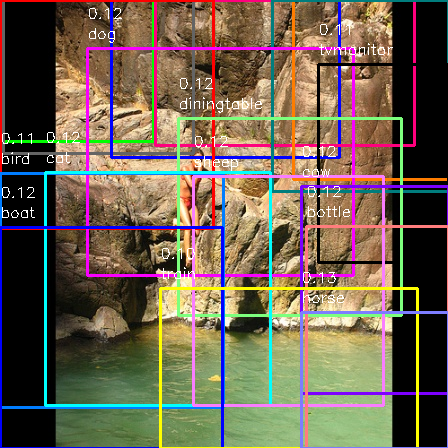

BBox shape: (20, 6)
BBox values: [[0.00000000e+00 0.00000000e+00 3.41563634e-01 3.15358700e-01
  1.18270434e-01 1.50000000e+01]
 [7.17849817e-03 0.00000000e+00 4.31940568e-01 3.41668738e-01
  1.24728009e-01 1.80000000e+01]
 [2.49840298e-01 0.00000000e+00 7.58598068e-01 3.52605637e-01
  1.05305739e-01 0.00000000e+00]
 [3.47344645e-01 0.00000000e+00 9.25239452e-01 3.24839179e-01
  1.02197602e-01 1.10000000e+01]
 [6.54901211e-01 0.00000000e+00 1.00000000e+00 4.01465195e-01
  1.25048399e-01 1.20000000e+01]
 [0.00000000e+00 0.00000000e+00 4.75751443e-01 5.10882463e-01
  1.28833264e-01 1.00000000e+01]
 [3.59025385e-01 0.00000000e+00 9.39602877e-01 4.37244311e-01
  9.85379592e-02 1.70000000e+01]
 [6.08409026e-01 0.00000000e+00 1.00000000e+00 4.26831458e-01
  1.04754657e-01 7.00000000e+00]
 [1.94760135e-01 1.08621938e-01 7.89418093e-01 6.13844020e-01
  1.21845894e-01 4.00000000e+00]
 [7.11404255e-01 1.43839025e-01 1.00000000e+00 5.86803549e-01
  1.12740092e-01 1.90000000e+01]
 [0.00000000e+00 

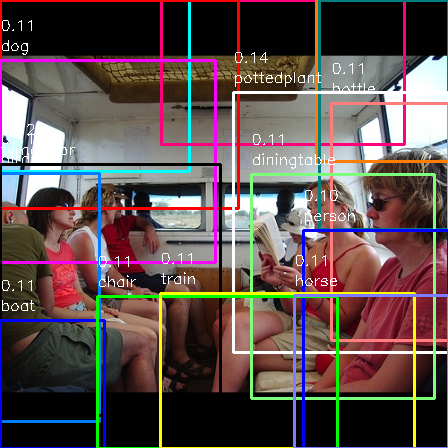

BBox shape: (20, 6)
BBox values: [[ 0.          0.          0.42193233  0.38316621  0.11046809  2.        ]
 [ 0.36067195  0.          0.90232629  0.32206567  0.12316517 11.        ]
 [ 0.70638411  0.          1.          0.36112636  0.11598666 12.        ]
 [ 0.          0.          0.53327027  0.46446743  0.10233429 10.        ]
 [ 0.71426362  0.          1.          0.51290685  0.10251194  7.        ]
 [ 0.          0.13464069  0.48154257  0.58595526  0.1141384   4.        ]
 [ 0.11106477  0.0761588   0.61950741  0.61866097  0.08968563  3.        ]
 [ 0.          0.22447479  0.32477464  0.76032919  0.09534412 18.        ]
 [ 0.          0.28922856  0.48302085  0.73345313  0.09319808  8.        ]
 [ 0.52071788  0.20754493  1.          0.78612549  0.13722399 17.        ]
 [ 0.74052284  0.23074615  1.          0.76022589  0.11158115 14.        ]
 [ 0.          0.38760147  0.22209299  0.9417319   0.11288806  1.        ]
 [ 0.          0.36761462  0.4914294   0.926957    0.12372678 19.  

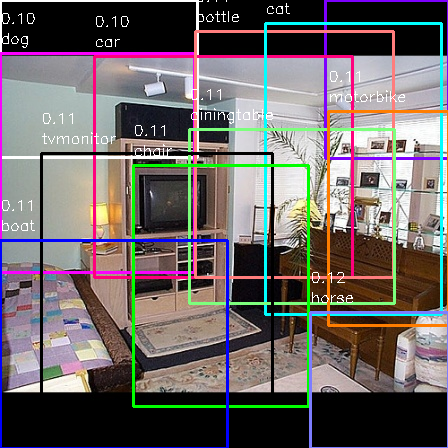

BBox shape: (19, 6)
BBox values: [[ 0.          0.          0.44077813  0.35059828  0.10203747 17.        ]
 [ 0.72598089  0.          1.          0.35376371  0.10614832  3.        ]
 [ 0.          0.          0.4893391   0.51723347  0.0925788  10.        ]
 [ 0.65963346  0.          1.          0.43276609  0.0969132   7.        ]
 [ 0.          0.11939523  0.43446611  0.60814587  0.10221643  4.        ]
 [ 0.21112784  0.12610318  0.78713318  0.61855226  0.10107321 11.        ]
 [ 0.43686795  0.06920022  0.87883776  0.61915827  0.10546754 14.        ]
 [ 0.59187328  0.05205374  0.98542081  0.70147317  0.11741617  2.        ]
 [ 0.          0.23084682  0.31533164  0.74677419  0.09459881 18.        ]
 [ 0.          0.28113038  0.47431577  0.72946385  0.0810918   8.        ]
 [ 0.42255161  0.28957455  0.88125149  0.67785923  0.11427075 16.        ]
 [ 0.49801883  0.23335406  1.          0.74693397  0.09309404 13.        ]
 [ 0.73313675  0.24919216  1.          0.72626171  0.10932627 12.  

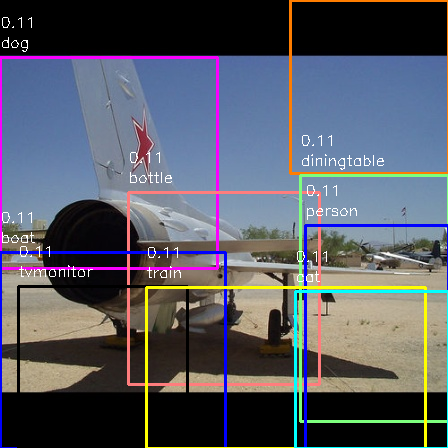

BBox shape: (19, 6)
BBox values: [[ 0.37462308  0.          0.90697773  0.32101462  0.0944474  11.        ]
 [ 0.6485539   0.          1.          0.38768034  0.10329925 12.        ]
 [ 0.          0.          0.46935219  0.51493027  0.09602176 10.        ]
 [ 0.26629147  0.04844689  0.73809329  0.41784039  0.09770829 15.        ]
 [ 0.          0.12878832  0.48609861  0.59884012  0.11144747  4.        ]
 [ 0.07715079  0.11756009  0.59287933  0.60105893  0.09699792  3.        ]
 [ 0.          0.22237873  0.30351368  0.75765473  0.09061848 18.        ]
 [ 0.          0.30769621  0.46763509  0.7092387   0.08996269  8.        ]
 [ 0.09044507  0.22179147  0.64061305  0.76720866  0.09614037  1.        ]
 [ 0.27448074  0.27952244  0.73653469  0.72576483  0.09528188  5.        ]
 [ 0.28608213  0.43009276  0.71225657  0.85844663  0.11367794 14.        ]
 [ 0.32742599  0.35834035  0.9495692   0.91742817  0.09773104  6.        ]
 [ 0.67151091  0.39256283  1.          0.94005808  0.10710287 16.  

In [ ]:
import os
import torch
from torch.utils.data import DataLoader
import torchvision.transforms as transforms
from PIL import Image
from google.colab.patches import cv2_imshow


COLOR = [(255,0,0),(255,125,0),(255,255,0),(255,0,125),(255,0,250),
         (255,125,125),(255,125,250),(125,125,0),(0,255,125),(255,0,0),
         (0,0,255),(125,0,255),(0,125,255),(0,255,255),(125,125,255),
         (0,255,0),(125,255,125),(255,255,255),(100,100,100),(0,0,0),]  # Used to mark the bbox colors for 20 categories, can be customized


class TestInterface(object):
    """
    Network test interface.
    main(): Main function for network testing.
    """
    def __init__(self, opts):
        self.opts = opts
        print("=======================Start inferring.=======================")

    def main(self):
        """
        Specific testing process
        """
        opts = self.opts
        img_list = os.listdir(opts.dataset_dir)
        trans = transforms.Compose([
            transforms.ToTensor(),
        ])
        model = torch.load('/content/checkpoints/epoch20.pkl', weights_only=False)
        if opts.use_GPU:
            model.to(opts.GPU_id)

        # Add a counter to limit the number of processed images to 20
        count = 0
        max_images = 20

        for img_name in img_list:
            if count >= max_images:  # If 20 images have been processed, exit the loop
                break

            img_path = os.path.join(opts.dataset_dir, img_name)
            img = Image.open(img_path).convert('RGB')
            img_tensor = trans(img)
            img_tensor = torch.unsqueeze(img_tensor, dim=0)
            print(img_name, img_tensor.shape)

            if opts.use_GPU:
                img_tensor = img_tensor.to(opts.GPU_id)

            # Model inference
            preds = torch.squeeze(model(img_tensor), dim=0).detach().cpu()
            preds = preds.permute(1, 2, 0)
            bbox = labels2bbox(preds)
            # print("Model output (preds):", preds)
            # Load the original image
            draw_img = cv2.imread(img_path)
            if draw_img is None:
                print(f"Failed to load image: {img_path}")
                continue

            # Draw bounding boxes
            self.draw_bbox(draw_img, bbox)
            print("BBox shape:", bbox.shape)  # Print the shape of bbox
            print("BBox values:", bbox)  # Print bbox values
            count += 1  # Update the counter

    def draw_bbox(self, img, bbox):
        """
        Draw bounding boxes on the image based on bbox information.
        :param img: The image to draw bbox on.
        :param bbox: Size (n,6), where 0:4 are (x1,y1,x2,y2), 4 is conf, 5 is cls.
        """
        h, w = img.shape[0:2]
        n = bbox.shape[0]
        print(f"Number of bounding boxes: {n}")  # Print the number of bbox
        print("BBox values:", bbox)  # Print bbox values

        for i in range(n):
            confidence = bbox[i, 4]
            if confidence < 0.1:  # Adjust confidence threshold
                continue

            # Scale coordinates to the original image size
            scale_x = w  # Original image width
            scale_y = h  # Original image height
            x1 = int(bbox[i, 0] * scale_x)
            y1 = int(bbox[i, 1] * scale_y)
            x2 = int(bbox[i, 2] * scale_x)
            y2 = int(bbox[i, 3] * scale_y)

            # Check if coordinates are within the image range
            if x1 < 0 or y1 < 0 or x2 > w or y2 > h:
                print(f"Box {i} is out of image bounds: ({x1}, {y1}) -> ({x2}, {y2})")
                continue

            # Check if coordinates are valid
            if x1 >= x2 or y1 >= y2:
                print(f"Invalid bounding box coordinates: ({x1}, {y1}) -> ({x2}, {y2})")
                continue

            # Get category name and color
            cls_name = GL_CLASSES[int(bbox[i, 5])]
            color = COLOR[int(bbox[i, 5])]

            # Print debug information
            print(f"Class: {cls_name}, Confidence: {confidence}, BBox: ({x1}, {y1}) -> ({x2}, {y2}), Color: {color}")

            # Draw bounding box
            cv2.rectangle(img, (x1, y1), (x2, y2), color, thickness=2)

            # Draw class name and confidence score
            cv2.putText(img, cls_name, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1)
            cv2.putText(img, f"{confidence:.2f}", (x1, y1 - 30), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1)

        # Display the image
        cv2_imshow(img)


if __name__ == '__main__':
    # Network test code
    args = Args()
    args.set_test_args()  # Get command line arguments
    test_interface = TestInterface(args.get_opts())
    test_interface.main()  # Call the test interface


use CPU to train.
=======================Start inferring.=======================
2008_001638.jpg torch.Size([1, 3, 448, 448])
Number of bounding boxes: 18
BBox values: [[ 0.10406434  0.          0.60720175  0.34981907  0.11479776  1.        ]
 [ 0.36028322  0.          0.90916273  0.33784184  0.1153306   4.        ]
 [ 0.          0.          0.46329392  0.52514008  0.09184643 10.        ]
 [ 0.1265462   0.          0.59817004  0.48225015  0.11032207 13.        ]
 [ 0.37719226  0.          0.93915731  0.49994445  0.10065036 17.        ]
 [ 0.73993772  0.          1.          0.52210735  0.08939692  7.        ]
 [ 0.54107372  0.03436565  1.          0.69447469  0.12011177  2.        ]
 [ 0.65581061  0.10865945  1.          0.60195929  0.10470362 14.        ]
 [ 0.          0.22344415  0.30939908  0.78182052  0.11036228 18.        ]
 [ 0.          0.26879699  0.46419876  0.71610267  0.08409516  8.        ]
 [ 0.13841285  0.19492071  0.59218146  0.78133093  0.08831299  0.        ]
 [ 0.36

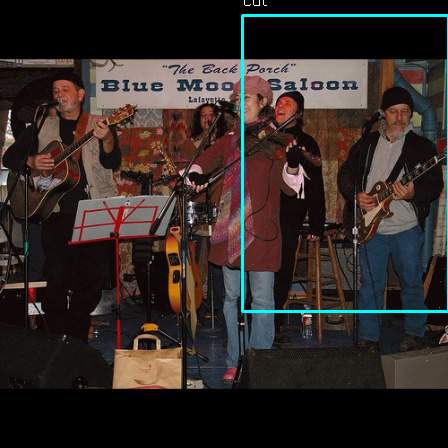

BBox shape: (18, 6)
BBox values: [[ 0.10406434  0.          0.60720175  0.34981907  0.11479776  1.        ]
 [ 0.36028322  0.          0.90916273  0.33784184  0.1153306   4.        ]
 [ 0.          0.          0.46329392  0.52514008  0.09184643 10.        ]
 [ 0.1265462   0.          0.59817004  0.48225015  0.11032207 13.        ]
 [ 0.37719226  0.          0.93915731  0.49994445  0.10065036 17.        ]
 [ 0.73993772  0.          1.          0.52210735  0.08939692  7.        ]
 [ 0.54107372  0.03436565  1.          0.69447469  0.12011177  2.        ]
 [ 0.65581061  0.10865945  1.          0.60195929  0.10470362 14.        ]
 [ 0.          0.22344415  0.30939908  0.78182052  0.11036228 18.        ]
 [ 0.          0.26879699  0.46419876  0.71610267  0.08409516  8.        ]
 [ 0.13841285  0.19492071  0.59218146  0.78133093  0.08831299  0.        ]
 [ 0.36670891  0.23934264  0.88375024  0.75640053  0.10472506 16.        ]
 [ 0.14711029  0.3810287   0.56802065  0.89137553  0.08490234 12.  

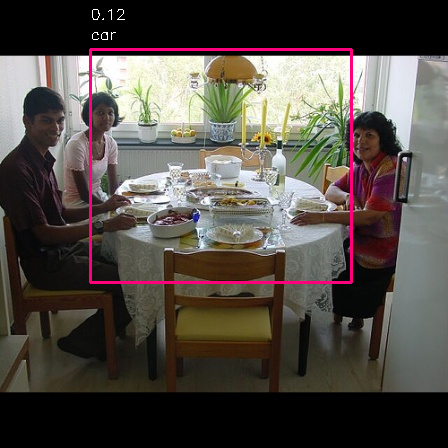

BBox shape: (19, 6)
BBox values: [[0.00000000e+00 0.00000000e+00 4.39378536e-01 3.74199910e-01
  1.14192620e-01 1.70000000e+01]
 [6.91542751e-01 0.00000000e+00 1.00000000e+00 3.78674226e-01
  1.05216645e-01 1.20000000e+01]
 [0.00000000e+00 0.00000000e+00 4.77421539e-01 4.88499152e-01
  1.10559881e-01 1.80000000e+01]
 [0.00000000e+00 1.40990147e-01 4.47548975e-01 5.93863734e-01
  1.11837596e-01 2.00000000e+00]
 [1.15733362e-01 1.23809404e-01 6.04789740e-01 5.72065211e-01
  9.69980955e-02 3.00000000e+00]
 [2.02613192e-01 1.11358247e-01 7.83896165e-01 6.29815957e-01
  1.20388761e-01 1.10000000e+01]
 [0.00000000e+00 2.61139008e-01 4.91045884e-01 7.54244032e-01
  8.63466486e-02 8.00000000e+00]
 [7.96599346e-02 2.46745471e-01 6.40789803e-01 7.61458222e-01
  9.83005986e-02 7.00000000e+00]
 [5.20280634e-01 2.33652779e-01 1.00000000e+00 7.83267447e-01
  1.15563825e-01 1.00000000e+01]
 [0.00000000e+00 4.09490251e-01 4.62559206e-01 9.04512637e-01
  8.12884718e-02 1.00000000e+00]
 [2.74196787e-01 

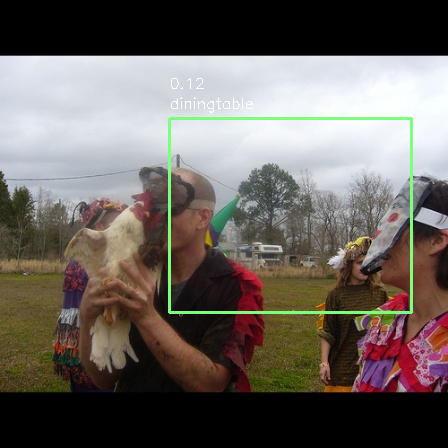

BBox shape: (20, 6)
BBox values: [[ 0.36485176  0.          0.9160866   0.34029033  0.11236723 11.        ]
 [ 0.          0.          0.28940583  0.43311176  0.10282294  9.        ]
 [ 0.64346687  0.          1.          0.44565839  0.10102185  7.        ]
 [ 0.          0.12940115  0.30283846  0.59847042  0.09908024 12.        ]
 [ 0.          0.23464412  0.32303535  0.74822135  0.08063566 18.        ]
 [ 0.09126444  0.22646786  0.64011701  0.77839209  0.10687046  8.        ]
 [ 0.21875067  0.28997104  0.77834345  0.69608237  0.09173732  5.        ]
 [ 0.37935711  0.26488785  0.91816641  0.69862826  0.1245345  16.        ]
 [ 0.51727854  0.2413732   1.          0.77203705  0.09222656 13.        ]
 [ 0.75216795  0.20982214  1.          0.76290508  0.11311372 14.        ]
 [ 0.          0.40536218  0.24334692  0.91528176  0.11145391  2.        ]
 [ 0.          0.36630782  0.45199015  0.92056313  0.09108281  1.        ]
 [ 0.45201434  0.38814876  0.84104748  0.9022244   0.09988181  6.  

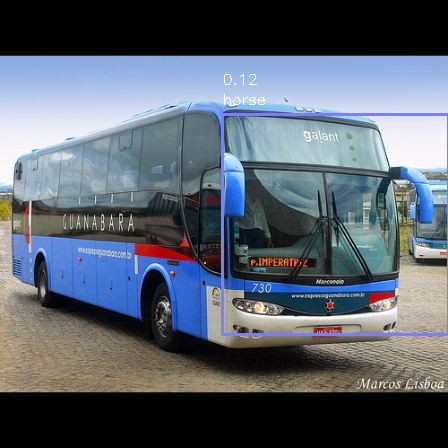

BBox shape: (16, 6)
BBox values: [[0.00000000e+00 0.00000000e+00 3.65846996e-01 2.98254032e-01
  1.08818397e-01 9.00000000e+00]
 [0.00000000e+00 0.00000000e+00 4.42238210e-01 4.05270479e-01
  8.56724009e-02 1.70000000e+01]
 [7.47703825e-02 0.00000000e+00 6.38492337e-01 3.27285877e-01
  9.62489843e-02 1.60000000e+01]
 [3.30030122e-01 0.00000000e+00 9.27577832e-01 3.15654842e-01
  9.61515382e-02 1.10000000e+01]
 [4.72860873e-01 0.00000000e+00 1.00000000e+00 3.23178781e-01
  1.02084607e-01 1.00000000e+01]
 [7.07373547e-01 0.00000000e+00 1.00000000e+00 3.81810686e-01
  9.79720280e-02 1.20000000e+01]
 [0.00000000e+00 1.32457158e-01 4.85425787e-01 5.94230017e-01
  9.86123085e-02 4.00000000e+00]
 [8.18683462e-02 1.16943845e-01 5.90838964e-01 5.89570769e-01
  9.89628956e-02 3.00000000e+00]
 [4.10013580e-01 3.83624051e-02 9.02395123e-01 7.01250515e-01
  1.03214942e-01 1.40000000e+01]
 [5.44409922e-01 8.11745737e-02 1.00000000e+00 6.81488297e-01
  1.00068256e-01 2.00000000e+00]
 [4.97259544e-01 

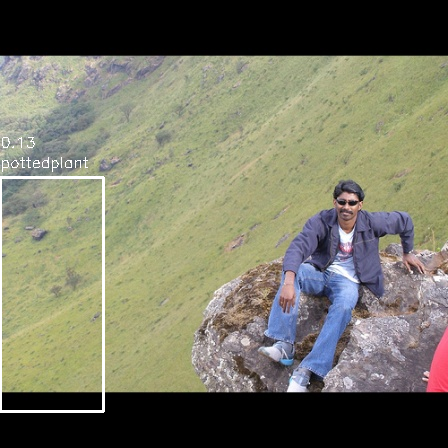

BBox shape: (17, 6)
BBox values: [[3.28245303e-01 0.00000000e+00 9.39461253e-01 3.33905233e-01
  1.07419163e-01 1.10000000e+01]
 [6.72129789e-01 0.00000000e+00 1.00000000e+00 3.46906951e-01
  1.15259394e-01 1.20000000e+01]
 [1.29289110e-01 0.00000000e+00 5.85134138e-01 4.57737901e-01
  1.12214312e-01 2.00000000e+00]
 [5.09039415e-01 8.40884447e-03 1.00000000e+00 4.23739612e-01
  1.26390308e-01 1.60000000e+01]
 [6.17940430e-01 0.00000000e+00 1.00000000e+00 4.32839300e-01
  1.21335089e-01 1.30000000e+01]
 [6.05034573e-02 1.00971886e-01 6.05890427e-01 6.08020672e-01
  1.08171746e-01 3.00000000e+00]
 [2.11459041e-01 1.30111130e-01 7.82054603e-01 6.18041160e-01
  1.16544299e-01 4.00000000e+00]
 [6.62402013e-01 1.34011179e-01 1.00000000e+00 5.99209040e-01
  1.12313919e-01 1.90000000e+01]
 [0.00000000e+00 2.05178022e-01 3.27567688e-01 7.66574502e-01
  9.82597172e-02 1.80000000e+01]
 [0.00000000e+00 2.77145277e-01 4.68949676e-01 7.27738779e-01
  9.03021097e-02 8.00000000e+00]
 [1.57723648e-01 

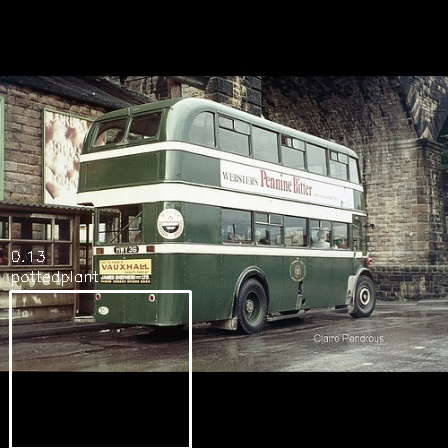

BBox shape: (20, 6)
BBox values: [[ 0.          0.          0.36477435  0.34321672  0.10689917 15.        ]
 [ 0.10486794  0.          0.62203074  0.34759745  0.09256919  6.        ]
 [ 0.34741486  0.          0.92926605  0.28557983  0.10514311 11.        ]
 [ 0.          0.14157359  0.43884626  0.59822843  0.11351869 12.        ]
 [ 0.43313     0.08042659  0.89689395  0.60692026  0.0944589  14.        ]
 [ 0.57278633  0.06458598  1.          0.6900416   0.09559934  2.        ]
 [ 0.64444661  0.11474864  1.          0.61265878  0.09612875 19.        ]
 [ 0.          0.24366641  0.28212957  0.75432109  0.11118866 18.        ]
 [ 0.          0.28148382  0.48480176  0.73696916  0.08752221  8.        ]
 [ 0.          0.36593318  0.46200678  0.92725486  0.08242122  1.        ]
 [ 0.51852609  0.40488451  1.          0.8715215   0.10942464 16.        ]
 [ 0.65998325  0.40358211  1.          0.88193552  0.10208847  7.        ]
 [ 0.          0.54998473  0.25449366  1.          0.09501781 13.  

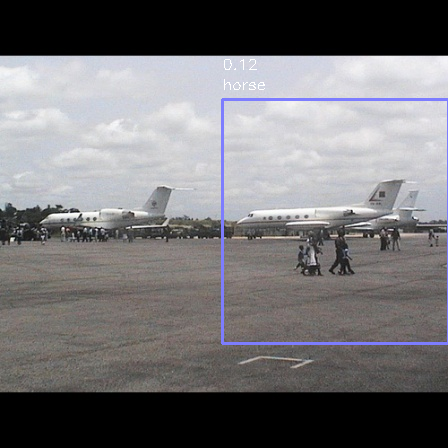

BBox shape: (18, 6)
BBox values: [[3.32650815e-01 0.00000000e+00 9.25477539e-01 3.40850396e-01
  1.09971382e-01 1.10000000e+01]
 [5.01497767e-01 0.00000000e+00 1.00000000e+00 3.02477943e-01
  1.08428396e-01 3.00000000e+00]
 [0.00000000e+00 0.00000000e+00 5.19359082e-01 4.66178373e-01
  9.89792645e-02 1.80000000e+01]
 [3.37956458e-01 0.00000000e+00 9.68632787e-01 4.55850041e-01
  9.83915254e-02 1.70000000e+01]
 [5.00495702e-01 5.04792375e-03 1.00000000e+00 4.35134983e-01
  1.02209933e-01 1.60000000e+01]
 [0.00000000e+00 1.19148465e-01 3.04247413e-01 6.04102792e-01
  1.01655856e-01 2.00000000e+00]
 [2.01481840e-01 1.18088015e-01 8.03798280e-01 6.29401692e-01
  1.01750582e-01 4.00000000e+00]
 [4.13491624e-01 9.24341423e-02 8.99736660e-01 6.03998218e-01
  1.10254250e-01 1.40000000e+01]
 [0.00000000e+00 2.59503343e-01 4.62269038e-01 7.23881879e-01
  9.30624679e-02 8.00000000e+00]
 [4.97587379e-01 2.22716783e-01 1.00000000e+00 7.66373132e-01
  1.22291215e-01 5.00000000e+00]
 [0.00000000e+00 

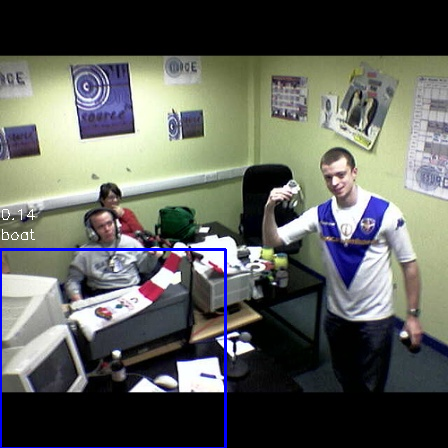

BBox shape: (17, 6)
BBox values: [[7.07014124e-01 0.00000000e+00 1.00000000e+00 3.62699917e-01
  1.00922488e-01 4.00000000e+00]
 [0.00000000e+00 0.00000000e+00 4.94827654e-01 5.11031530e-01
  1.00414895e-01 1.80000000e+01]
 [4.94944062e-01 1.39366942e-02 1.00000000e+00 4.14045508e-01
  1.08285449e-01 1.60000000e+01]
 [6.35958612e-02 1.10288535e-01 6.33636743e-01 5.87580775e-01
  1.11260913e-01 3.00000000e+00]
 [6.73826652e-01 8.49554326e-02 1.00000000e+00 6.37628236e-01
  1.15154885e-01 1.40000000e+01]
 [4.05803504e-01 2.57942936e-01 8.68696900e-01 7.61586866e-01
  1.27736732e-01 1.70000000e+01]
 [5.21297851e-01 2.32211100e-01 1.00000000e+00 7.90454434e-01
  1.11560486e-01 1.00000000e+01]
 [0.00000000e+00 3.88461390e-01 4.58857715e-01 9.20515158e-01
  9.40552652e-02 1.00000000e+00]
 [1.45023951e-01 4.12754687e-01 5.53176829e-01 8.69760158e-01
  8.93956423e-02 1.20000000e+01]
 [2.63529822e-01 3.70593590e-01 7.25529924e-01 9.36655683e-01
  1.04382381e-01 1.50000000e+01]
 [3.35134098e-01 

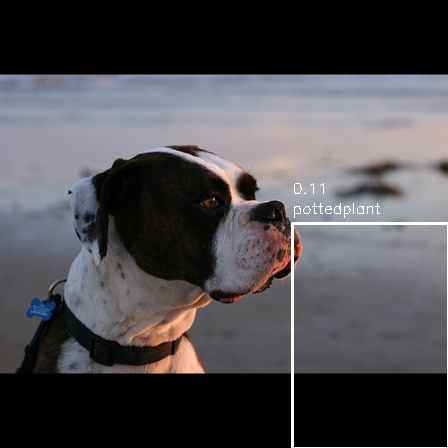

BBox shape: (20, 6)
BBox values: [[ 0.          0.          0.35459943  0.35082815  0.10340882  9.        ]
 [ 0.11227499  0.          0.60782201  0.34286188  0.09159282  6.        ]
 [ 0.27691913  0.          0.72653937  0.38807378  0.09024546  0.        ]
 [ 0.49610264  0.          1.          0.29332802  0.08947502  3.        ]
 [ 0.73326484  0.          1.          0.3596811   0.10324024 12.        ]
 [ 0.          0.          0.28812042  0.46301816  0.0931164   1.        ]
 [ 0.          0.          0.50748714  0.45002814  0.09921293  7.        ]
 [ 0.24993295  0.02759742  0.75853074  0.4281781   0.09628728 15.        ]
 [ 0.          0.14261857  0.44716256  0.58476347  0.10285833  2.        ]
 [ 0.07088693  0.13958289  0.60437329  0.57076826  0.09563497 19.        ]
 [ 0.          0.21476408  0.30062859  0.78894313  0.09024855 18.        ]
 [ 0.39637009  0.29144381  0.91297839  0.67213846  0.10978456 16.        ]
 [ 0.51115397  0.21971845  1.          0.7488833   0.10189407 13.  

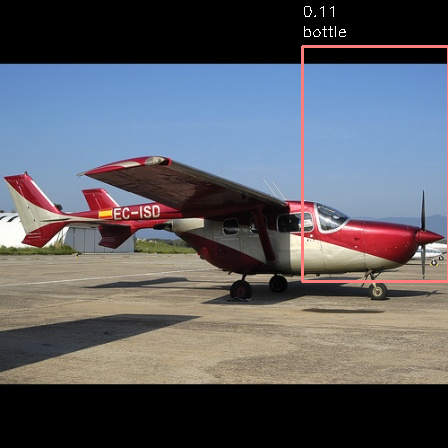

BBox shape: (19, 6)
BBox values: [[ 0.          0.          0.41483599  0.359492    0.09610321 13.        ]
 [ 0.11267423  0.          0.60619055  0.32525811  0.08931032 11.        ]
 [ 0.21769255  0.          0.80480325  0.32895046  0.10104467  0.        ]
 [ 0.          0.          0.29730485  0.41864533  0.09888238 12.        ]
 [ 0.          0.          0.44835493  0.51623668  0.09188467 18.        ]
 [ 0.36451086  0.          0.94819632  0.44768668  0.09822427  5.        ]
 [ 0.61841066  0.          1.          0.43491035  0.09971185  7.        ]
 [ 0.          0.14628144  0.43111108  0.58155231  0.10361017  4.        ]
 [ 0.5730026   0.04534067  1.          0.71197118  0.10038541  2.        ]
 [ 0.67456207  0.10355295  1.          0.62729306  0.1105772  14.        ]
 [ 0.06895796  0.2292299   0.64784101  0.77580157  0.08215546  8.        ]
 [ 0.39455587  0.25353333  0.90338374  0.70899739  0.09817906 16.        ]
 [ 0.          0.38742558  0.47480031  0.89903013  0.09731112  1.  

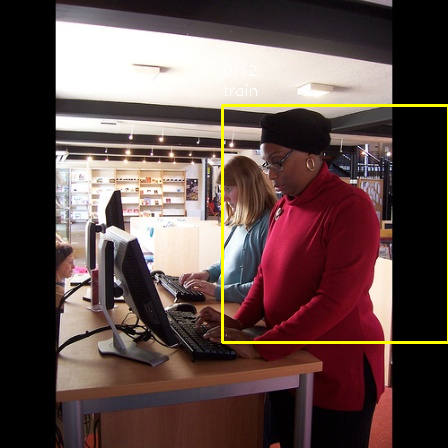

BBox shape: (17, 6)
BBox values: [[ 0.38351419  0.          0.89205506  0.30818881  0.09029458 11.        ]
 [ 0.64859493  0.          1.          0.36418214  0.0890795  12.        ]
 [ 0.40604185  0.          0.9139558   0.51403541  0.08823478 17.        ]
 [ 0.          0.11007259  0.47063463  0.61296353  0.1008986   2.        ]
 [ 0.18224633  0.12280606  0.80631167  0.62137186  0.0990978   4.        ]
 [ 0.41933336  0.04217335  0.90519627  0.6948944   0.1149337  14.        ]
 [ 0.          0.20937871  0.32176771  0.7842344   0.09585933  7.        ]
 [ 0.39935607  0.30726412  0.90557057  0.66554465  0.11164385 16.        ]
 [ 0.49682329  0.23475299  1.          0.76481095  0.12150604 13.        ]
 [ 0.          0.43507643  0.34876154  0.88420336  0.10149598  1.        ]
 [ 0.          0.39151136  0.5132599   0.90846232  0.10595223 19.        ]
 [ 0.28328958  0.38741481  0.69799492  0.89565152  0.09511392 15.        ]
 [ 0.66213436  0.36868453  1.          0.97304547  0.09506713  0.  

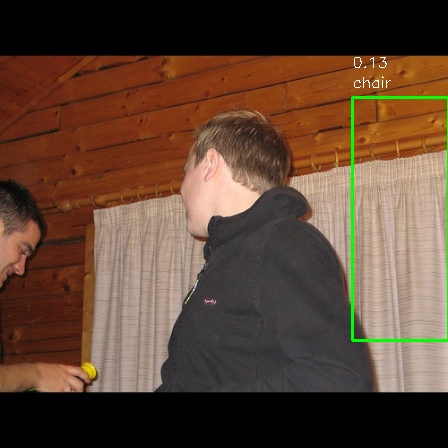

BBox shape: (19, 6)
BBox values: [[ 0.          0.          0.43035353  0.35593058  0.11079087 17.        ]
 [ 0.08799322  0.          0.61107047  0.35312088  0.12399942  6.        ]
 [ 0.38120509  0.          0.89078093  0.33271021  0.09655996 11.        ]
 [ 0.          0.          0.49983911  0.49011141  0.10494491 10.        ]
 [ 0.64091726  0.          1.          0.43034675  0.11544043  7.        ]
 [ 0.          0.153719    0.48318711  0.58341091  0.12586103  4.        ]
 [ 0.1052902   0.13044593  0.61579248  0.58043885  0.08574191  3.        ]
 [ 0.40894322  0.02394604  0.89260815  0.69518894  0.1015765  14.        ]
 [ 0.53895032  0.07082165  1.          0.6762293   0.11242145  2.        ]
 [ 0.          0.25809437  0.29435183  0.72503886  0.09662136 18.        ]
 [ 0.          0.25451753  0.48152495  0.75953487  0.0909412   8.        ]
 [ 0.27994579  0.27594541  0.73173895  0.71240725  0.11592475  5.        ]
 [ 0.78731352  0.2174093   1.          0.75944237  0.13052332 15.  

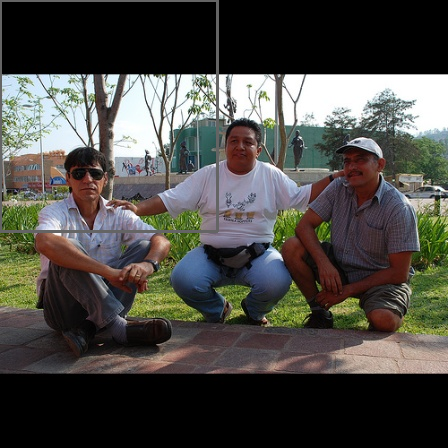

BBox shape: (19, 6)
BBox values: [[ 0.11598468  0.          0.60727412  0.32763601  0.10727555 11.        ]
 [ 0.70301916  0.          1.          0.34704397  0.11572077 12.        ]
 [ 0.          0.          0.26276679  0.44729209  0.10204475  9.        ]
 [ 0.          0.          0.48479654  0.51684025  0.12778559 18.        ]
 [ 0.          0.14023506  0.44708084  0.60066005  0.11410432  2.        ]
 [ 0.06339449  0.11958206  0.61357731  0.58773229  0.09080428  3.        ]
 [ 0.17612119  0.11491343  0.81193228  0.61448874  0.08516248  4.        ]
 [ 0.40491503  0.04790894  0.90933079  0.70297459  0.1138179  14.        ]
 [ 0.          0.3018895   0.49734695  0.70557927  0.08025014  8.        ]
 [ 0.16011055  0.18939629  0.56716373  0.78143504  0.10824514  7.        ]
 [ 0.          0.40206678  0.21870237  0.92836667  0.11222398 17.        ]
 [ 0.          0.42026143  0.4780733   0.89034187  0.11783751 19.        ]
 [ 0.33594852  0.34901249  0.95594692  0.92675536  0.10964336  6.  

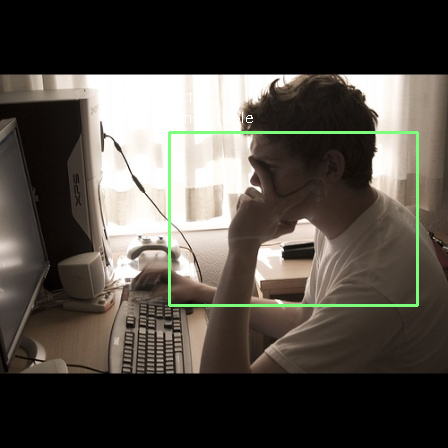

BBox shape: (19, 6)
BBox values: [[0.00000000e+00 0.00000000e+00 4.20978940e-01 3.77398925e-01
  9.96707156e-02 1.80000000e+01]
 [1.00356268e-01 0.00000000e+00 6.15020620e-01 3.29272198e-01
  1.09308444e-01 1.10000000e+01]
 [3.33017741e-01 0.00000000e+00 9.32289813e-01 3.40897309e-01
  8.93735588e-02 8.00000000e+00]
 [0.00000000e+00 0.00000000e+00 4.91986773e-01 4.67387634e-01
  9.99725536e-02 7.00000000e+00]
 [0.00000000e+00 1.41547978e-01 4.96661689e-01 5.87473333e-01
  1.17078565e-01 2.00000000e+00]
 [3.78705123e-01 2.95741154e-01 9.32566085e-01 6.81893063e-01
  1.26480326e-01 1.60000000e+01]
 [5.21780785e-01 2.27848692e-01 1.00000000e+00 7.81587643e-01
  9.82021019e-02 1.00000000e+01]
 [7.29958860e-01 2.07151413e-01 1.00000000e+00 7.80839741e-01
  1.04441039e-01 1.50000000e+01]
 [0.00000000e+00 3.84878725e-01 4.34734583e-01 9.23191220e-01
  1.13029987e-01 1.00000000e+00]
 [1.50272989e-01 3.81724702e-01 5.49409383e-01 8.92787444e-01
  1.26038164e-01 1.20000000e+01]
 [2.62151290e-01 

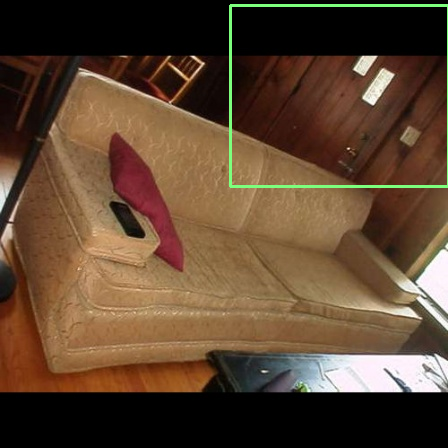

BBox shape: (19, 6)
BBox values: [[0.00000000e+00 0.00000000e+00 3.44186021e-01 3.10012187e-01
  1.06783524e-01 1.50000000e+01]
 [0.00000000e+00 0.00000000e+00 4.51038965e-01 3.59748576e-01
  1.22299477e-01 1.70000000e+01]
 [3.64924861e-01 0.00000000e+00 9.01357485e-01 3.49462266e-01
  9.86483768e-02 1.10000000e+01]
 [4.95290467e-01 0.00000000e+00 1.00000000e+00 3.17401226e-01
  1.26137689e-01 1.80000000e+01]
 [0.00000000e+00 0.00000000e+00 4.84830869e-01 4.93908499e-01
  1.36157542e-01 1.00000000e+01]
 [5.14883693e-01 1.27481605e-02 1.00000000e+00 4.15798643e-01
  1.40458420e-01 1.60000000e+01]
 [0.00000000e+00 1.26599780e-01 3.21648538e-01 6.08126751e-01
  1.04914255e-01 2.00000000e+00]
 [0.00000000e+00 1.42807158e-01 4.74259887e-01 5.85462572e-01
  1.34373933e-01 1.20000000e+01]
 [6.56616569e-01 1.19304691e-01 1.00000000e+00 6.08599101e-01
  1.38595045e-01 1.40000000e+01]
 [2.46120108e-01 2.76730095e-01 7.51296056e-01 7.11467062e-01
  1.15463629e-01 8.00000000e+00]
 [5.06016940e-01 

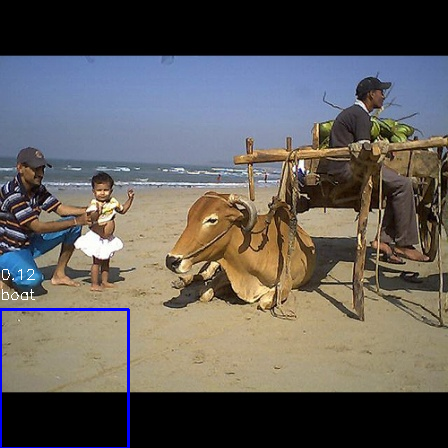

BBox shape: (17, 6)
BBox values: [[4.25236566e-03 0.00000000e+00 3.95806304e-01 3.64065851e-01
  1.08676299e-01 1.70000000e+01]
 [9.60561718e-02 0.00000000e+00 6.20050856e-01 3.53394006e-01
  9.89886969e-02 1.10000000e+01]
 [6.76783411e-01 0.00000000e+00 1.00000000e+00 3.85605799e-01
  1.17111750e-01 1.20000000e+01]
 [0.00000000e+00 0.00000000e+00 4.67772646e-01 5.12611287e-01
  1.02704078e-01 1.30000000e+01]
 [5.08572791e-01 0.00000000e+00 1.00000000e+00 4.16448866e-01
  1.14286460e-01 1.60000000e+01]
 [0.00000000e+00 1.16815563e-01 4.64567763e-01 6.11906107e-01
  1.11855336e-01 4.00000000e+00]
 [5.61532617e-01 5.81669084e-02 1.00000000e+00 6.76879989e-01
  1.20989129e-01 2.00000000e+00]
 [6.63994972e-01 1.07144454e-01 1.00000000e+00 6.11844220e-01
  1.12485461e-01 1.40000000e+01]
 [0.00000000e+00 2.73014309e-01 5.20791428e-01 7.39088806e-01
  9.09534916e-02 6.00000000e+00]
 [9.03000150e-02 2.23294531e-01 6.39508895e-01 7.78080140e-01
  9.22607481e-02 7.00000000e+00]
 [2.45666721e-01 

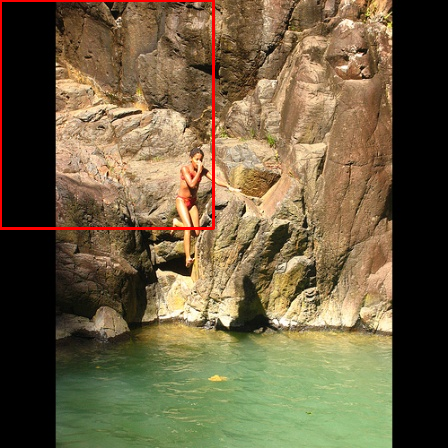

BBox shape: (20, 6)
BBox values: [[0.00000000e+00 0.00000000e+00 3.41563634e-01 3.15358700e-01
  1.18270434e-01 1.50000000e+01]
 [7.17849817e-03 0.00000000e+00 4.31940568e-01 3.41668738e-01
  1.24728009e-01 1.80000000e+01]
 [2.49840298e-01 0.00000000e+00 7.58598068e-01 3.52605637e-01
  1.05305739e-01 0.00000000e+00]
 [3.47344645e-01 0.00000000e+00 9.25239452e-01 3.24839179e-01
  1.02197602e-01 1.10000000e+01]
 [6.54901211e-01 0.00000000e+00 1.00000000e+00 4.01465195e-01
  1.25048399e-01 1.20000000e+01]
 [0.00000000e+00 0.00000000e+00 4.75751443e-01 5.10882463e-01
  1.28833264e-01 1.00000000e+01]
 [3.59025385e-01 0.00000000e+00 9.39602877e-01 4.37244311e-01
  9.85379592e-02 1.70000000e+01]
 [6.08409026e-01 0.00000000e+00 1.00000000e+00 4.26831458e-01
  1.04754657e-01 7.00000000e+00]
 [1.94760135e-01 1.08621938e-01 7.89418093e-01 6.13844020e-01
  1.21845894e-01 4.00000000e+00]
 [7.11404255e-01 1.43839025e-01 1.00000000e+00 5.86803549e-01
  1.12740092e-01 1.90000000e+01]
 [0.00000000e+00 

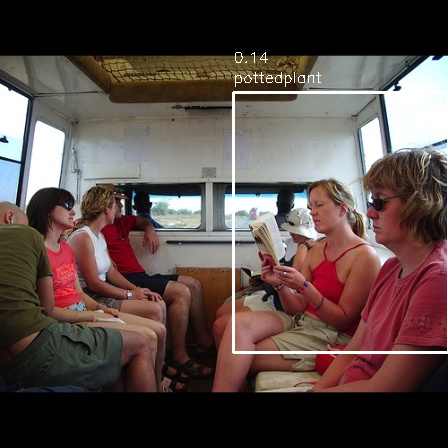

BBox shape: (20, 6)
BBox values: [[ 0.          0.          0.42193233  0.38316621  0.11046809  2.        ]
 [ 0.36067195  0.          0.90232629  0.32206567  0.12316517 11.        ]
 [ 0.70638411  0.          1.          0.36112636  0.11598666 12.        ]
 [ 0.          0.          0.53327027  0.46446743  0.10233429 10.        ]
 [ 0.71426362  0.          1.          0.51290685  0.10251194  7.        ]
 [ 0.          0.13464069  0.48154257  0.58595526  0.1141384   4.        ]
 [ 0.11106477  0.0761588   0.61950741  0.61866097  0.08968563  3.        ]
 [ 0.          0.22447479  0.32477464  0.76032919  0.09534412 18.        ]
 [ 0.          0.28922856  0.48302085  0.73345313  0.09319808  8.        ]
 [ 0.52071788  0.20754493  1.          0.78612549  0.13722399 17.        ]
 [ 0.74052284  0.23074615  1.          0.76022589  0.11158115 14.        ]
 [ 0.          0.38760147  0.22209299  0.9417319   0.11288806  1.        ]
 [ 0.          0.36761462  0.4914294   0.926957    0.12372678 19.  

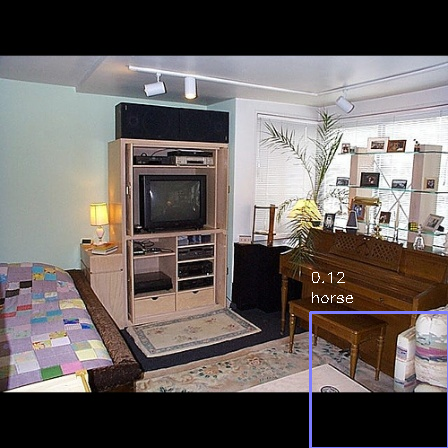

BBox shape: (19, 6)
BBox values: [[ 0.          0.          0.44077813  0.35059828  0.10203747 17.        ]
 [ 0.72598089  0.          1.          0.35376371  0.10614832  3.        ]
 [ 0.          0.          0.4893391   0.51723347  0.0925788  10.        ]
 [ 0.65963346  0.          1.          0.43276609  0.0969132   7.        ]
 [ 0.          0.11939523  0.43446611  0.60814587  0.10221643  4.        ]
 [ 0.21112784  0.12610318  0.78713318  0.61855226  0.10107321 11.        ]
 [ 0.43686795  0.06920022  0.87883776  0.61915827  0.10546754 14.        ]
 [ 0.59187328  0.05205374  0.98542081  0.70147317  0.11741617  2.        ]
 [ 0.          0.23084682  0.31533164  0.74677419  0.09459881 18.        ]
 [ 0.          0.28113038  0.47431577  0.72946385  0.0810918   8.        ]
 [ 0.42255161  0.28957455  0.88125149  0.67785923  0.11427075 16.        ]
 [ 0.49801883  0.23335406  1.          0.74693397  0.09309404 13.        ]
 [ 0.73313675  0.24919216  1.          0.72626171  0.10932627 12.  

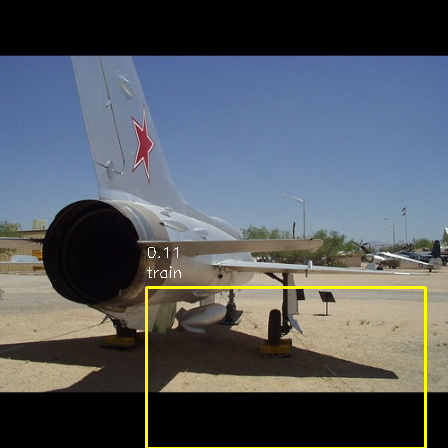

BBox shape: (19, 6)
BBox values: [[ 0.37462308  0.          0.90697773  0.32101462  0.0944474  11.        ]
 [ 0.6485539   0.          1.          0.38768034  0.10329925 12.        ]
 [ 0.          0.          0.46935219  0.51493027  0.09602176 10.        ]
 [ 0.26629147  0.04844689  0.73809329  0.41784039  0.09770829 15.        ]
 [ 0.          0.12878832  0.48609861  0.59884012  0.11144747  4.        ]
 [ 0.07715079  0.11756009  0.59287933  0.60105893  0.09699792  3.        ]
 [ 0.          0.22237873  0.30351368  0.75765473  0.09061848 18.        ]
 [ 0.          0.30769621  0.46763509  0.7092387   0.08996269  8.        ]
 [ 0.09044507  0.22179147  0.64061305  0.76720866  0.09614037  1.        ]
 [ 0.27448074  0.27952244  0.73653469  0.72576483  0.09528188  5.        ]
 [ 0.28608213  0.43009276  0.71225657  0.85844663  0.11367794 14.        ]
 [ 0.32742599  0.35834035  0.9495692   0.91742817  0.09773104  6.        ]
 [ 0.67151091  0.39256283  1.          0.94005808  0.10710287 16.  

In [ ]:
import os
import torch
from torch.utils.data import DataLoader
import torchvision.transforms as transforms
from PIL import Image
from google.colab.patches import cv2_imshow

# Colors used to indicate bounding boxes for 20 categories, can be customized
COLOR = [(255, 0, 0), (255, 125, 0), (255, 255, 0), (255, 0, 125), (255, 0, 250),
         (255, 125, 125), (255, 125, 250), (125, 125, 0), (0, 255, 125), (255, 0, 0),
         (0, 0, 255), (125, 0, 255), (0, 125, 255), (0, 255, 255), (125, 125, 255),
         (0, 255, 0), (125, 255, 125), (255, 255, 255), (100, 100, 100), (0, 0, 0)]


class TestInterface(object):
    """
    Network testing interface.
    main(): The main function for network testing.
    """

    def __init__(self, opts):
        self.opts = opts
        print("=======================Start inferring.=======================")

    def main(self):
        """
        Detailed testing process.
        """
        opts = self.opts
        img_list = os.listdir(opts.dataset_dir)
        trans = transforms.Compose([
            transforms.ToTensor(),
        ])
        model = torch.load('/content/checkpoints/epoch20.pkl', weights_only=False)
        if opts.use_GPU:
            model.to(opts.GPU_id)

        # Add a counter to limit processing to 20 images only
        count = 0
        max_images = 20

        for img_name in img_list:
            if count >= max_images:  # Exit the loop if 20 images have been processed
                break

            img_path = os.path.join(opts.dataset_dir, img_name)
            img = Image.open(img_path).convert('RGB')
            img_tensor = trans(img)
            img_tensor = torch.unsqueeze(img_tensor, dim=0)
            print(img_name, img_tensor.shape)

            if opts.use_GPU:
                img_tensor = img_tensor.to(opts.GPU_id)

            # Model inference
            preds = torch.squeeze(model(img_tensor), dim=0).detach().cpu()
            preds = preds.permute(1, 2, 0)
            bbox = labels2bbox(preds)

            # Load the original image
            draw_img = cv2.imread(img_path)
            if draw_img is None:
                print(f"Failed to load image: {img_path}")
                continue

            # Draw bounding boxes
            self.draw_bbox(draw_img, bbox)
            print("BBox shape:", bbox.shape)  # Print the shape of the bounding box
            print("BBox values:", bbox)  # Print bounding box values
            count += 1  # Update the counter

    def draw_bbox(self, img, bbox):
        """
        Draw the bounding box with the highest confidence on the image.
        :param img: The image on which the bounding box is drawn.
        :param bbox: A (n,6) array where 0:4 represent (x1, y1, x2, y2),
                     4 is confidence, and 5 is the class.
        """
        h, w = img.shape[0:2]
        n = bbox.shape[0]
        print(f"Number of bounding boxes: {n}")  # Print the number of bounding boxes
        print("BBox values:", bbox)  # Print bounding box values

        if n == 0:  # If no bounding box is detected
            print("No bounding boxes detected.")
            cv2_imshow(img)
            return

        # Find the bounding box with the highest confidence
        max_confidence_idx = np.argmax(bbox[:, 4])  # Get the index of the highest confidence
        best_bbox = bbox[max_confidence_idx]  # Get the bounding box with the highest confidence

        # Extract bounding box coordinates, confidence, and class
        confidence = best_bbox[4]
        if confidence < 0.1:  # Skip if confidence is below the threshold
            print("Best bounding box confidence is below threshold.")
            cv2_imshow(img)
            return

        # Scale coordinates to the original image size
        scale_x = w  # Original image width
        scale_y = h  # Original image height
        x1 = int(best_bbox[0] * scale_x)
        y1 = int(best_bbox[1] * scale_y)
        x2 = int(best_bbox[2] * scale_x)
        y2 = int(best_bbox[3] * scale_y)

        # Check if coordinates are within image bounds
        if x1 < 0 or y1 < 0 or x2 > w or y2 > h:
            print(f"Best bounding box is out of image bounds: ({x1}, {y1}) -> ({x2}, {y2})")
            cv2_imshow(img)
            return

        # Check if coordinates are valid
        if x1 >= x2 or y1 >= y2:
            print(f"Invalid bounding box coordinates: ({x1}, {y1}) -> ({x2}, {y2})")
            cv2_imshow(img)
            return

        # Get class name and color
        cls_name = GL_CLASSES[int(best_bbox[5])]
        color = COLOR[int(best_bbox[5])]

        # Debugging information
        print(f"Best bounding box - Class: {cls_name}, Confidence: {confidence}, BBox: ({x1}, {y1}) -> ({x2}, {y2}), Color: {color}")

        # Draw bounding box
        cv2.rectangle(img, (x1, y1), (x2, y2), color, thickness=2)

        # Draw class name and confidence score
        cv2.putText(img, cls_name, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1)
        cv2.putText(img, f"{confidence:.2f}", (x1, y1 - 30), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1)

        # Display image
        cv2_imshow(img)


if __name__ == '__main__':
    # Network testing script
    args = Args()
    args.set_test_args()  # Retrieve command-line arguments
    test_interface = TestInterface(args.get_opts())
    test_interface.main()  # Call the test interface


In [ ]:
import xml.etree.ElementTree as ET

def parse_voc_xml(xml_path):
    """
    Parse VOC format XML file to extract ground truth labels and bounding box information.
    :param xml_path: Path to the XML file.
    :return: A list containing ground truth labels and bounding box information,
             formatted as [{'class': cls_name, 'bbox': [x1, y1, x2, y2]}].
    """
    tree = ET.parse(xml_path)
    root = tree.getroot()

    gt_bboxes = []
    for obj in root.findall('object'):
        cls_name = obj.find('name').text  # Class name
        bbox = obj.find('bndbox')
        x1 = float(bbox.find('xmin').text)
        y1 = float(bbox.find('ymin').text)
        x2 = float(bbox.find('xmax').text)
        y2 = float(bbox.find('ymax').text)
        gt_bboxes.append({'class': cls_name, 'bbox': [x1, y1, x2, y2]})

    return gt_bboxes


use CPU to train.
=======================Start inferring.=======================
2008_001638.jpg torch.Size([1, 3, 448, 448])
Number of bounding boxes: 18
BBox values: [[ 0.10406434  0.          0.60720175  0.34981907  0.11479776  1.        ]
 [ 0.36028322  0.          0.90916273  0.33784184  0.1153306   4.        ]
 [ 0.          0.          0.46329392  0.52514008  0.09184643 10.        ]
 [ 0.1265462   0.          0.59817004  0.48225015  0.11032207 13.        ]
 [ 0.37719226  0.          0.93915731  0.49994445  0.10065036 17.        ]
 [ 0.73993772  0.          1.          0.52210735  0.08939692  7.        ]
 [ 0.54107372  0.03436565  1.          0.69447469  0.12011177  2.        ]
 [ 0.65581061  0.10865945  1.          0.60195929  0.10470362 14.        ]
 [ 0.          0.22344415  0.30939908  0.78182052  0.11036228 18.        ]
 [ 0.          0.26879699  0.46419876  0.71610267  0.08409516  8.        ]
 [ 0.13841285  0.19492071  0.59218146  0.78133093  0.08831299  0.        ]
 [ 0.36

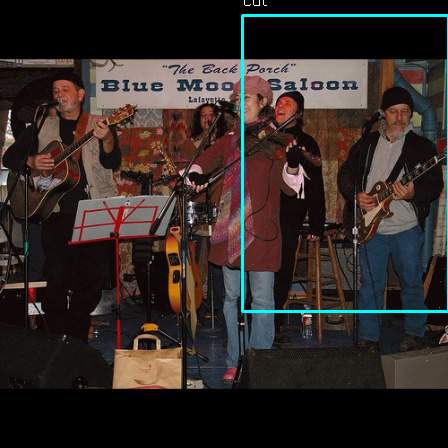

BBox shape: (18, 6)
BBox values: [[ 0.10406434  0.          0.60720175  0.34981907  0.11479776  1.        ]
 [ 0.36028322  0.          0.90916273  0.33784184  0.1153306   4.        ]
 [ 0.          0.          0.46329392  0.52514008  0.09184643 10.        ]
 [ 0.1265462   0.          0.59817004  0.48225015  0.11032207 13.        ]
 [ 0.37719226  0.          0.93915731  0.49994445  0.10065036 17.        ]
 [ 0.73993772  0.          1.          0.52210735  0.08939692  7.        ]
 [ 0.54107372  0.03436565  1.          0.69447469  0.12011177  2.        ]
 [ 0.65581061  0.10865945  1.          0.60195929  0.10470362 14.        ]
 [ 0.          0.22344415  0.30939908  0.78182052  0.11036228 18.        ]
 [ 0.          0.26879699  0.46419876  0.71610267  0.08409516  8.        ]
 [ 0.13841285  0.19492071  0.59218146  0.78133093  0.08831299  0.        ]
 [ 0.36670891  0.23934264  0.88375024  0.75640053  0.10472506 16.        ]
 [ 0.14711029  0.3810287   0.56802065  0.89137553  0.08490234 12.  

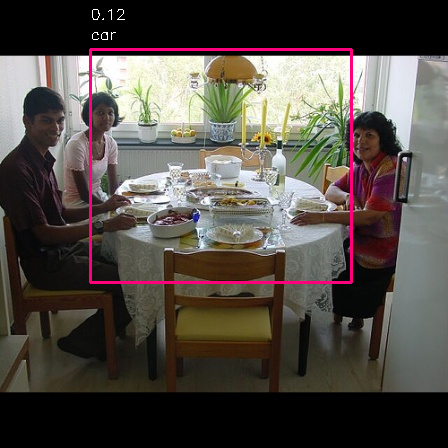

BBox shape: (19, 6)
BBox values: [[0.00000000e+00 0.00000000e+00 4.39378536e-01 3.74199910e-01
  1.14192620e-01 1.70000000e+01]
 [6.91542751e-01 0.00000000e+00 1.00000000e+00 3.78674226e-01
  1.05216645e-01 1.20000000e+01]
 [0.00000000e+00 0.00000000e+00 4.77421539e-01 4.88499152e-01
  1.10559881e-01 1.80000000e+01]
 [0.00000000e+00 1.40990147e-01 4.47548975e-01 5.93863734e-01
  1.11837596e-01 2.00000000e+00]
 [1.15733362e-01 1.23809404e-01 6.04789740e-01 5.72065211e-01
  9.69980955e-02 3.00000000e+00]
 [2.02613192e-01 1.11358247e-01 7.83896165e-01 6.29815957e-01
  1.20388761e-01 1.10000000e+01]
 [0.00000000e+00 2.61139008e-01 4.91045884e-01 7.54244032e-01
  8.63466486e-02 8.00000000e+00]
 [7.96599346e-02 2.46745471e-01 6.40789803e-01 7.61458222e-01
  9.83005986e-02 7.00000000e+00]
 [5.20280634e-01 2.33652779e-01 1.00000000e+00 7.83267447e-01
  1.15563825e-01 1.00000000e+01]
 [0.00000000e+00 4.09490251e-01 4.62559206e-01 9.04512637e-01
  8.12884718e-02 1.00000000e+00]
 [2.74196787e-01 

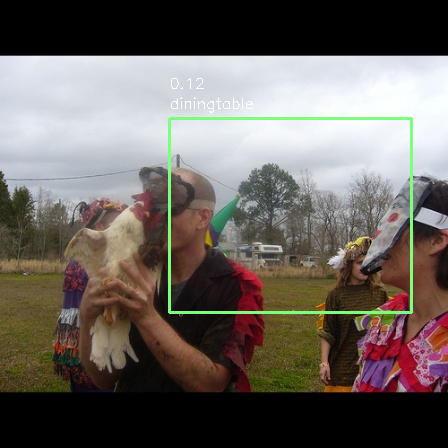

BBox shape: (20, 6)
BBox values: [[ 0.36485176  0.          0.9160866   0.34029033  0.11236723 11.        ]
 [ 0.          0.          0.28940583  0.43311176  0.10282294  9.        ]
 [ 0.64346687  0.          1.          0.44565839  0.10102185  7.        ]
 [ 0.          0.12940115  0.30283846  0.59847042  0.09908024 12.        ]
 [ 0.          0.23464412  0.32303535  0.74822135  0.08063566 18.        ]
 [ 0.09126444  0.22646786  0.64011701  0.77839209  0.10687046  8.        ]
 [ 0.21875067  0.28997104  0.77834345  0.69608237  0.09173732  5.        ]
 [ 0.37935711  0.26488785  0.91816641  0.69862826  0.1245345  16.        ]
 [ 0.51727854  0.2413732   1.          0.77203705  0.09222656 13.        ]
 [ 0.75216795  0.20982214  1.          0.76290508  0.11311372 14.        ]
 [ 0.          0.40536218  0.24334692  0.91528176  0.11145391  2.        ]
 [ 0.          0.36630782  0.45199015  0.92056313  0.09108281  1.        ]
 [ 0.45201434  0.38814876  0.84104748  0.9022244   0.09988181  6.  

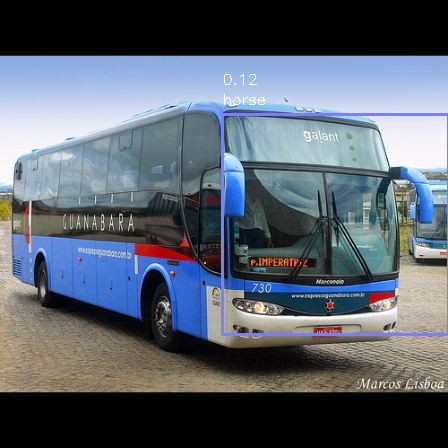

BBox shape: (16, 6)
BBox values: [[0.00000000e+00 0.00000000e+00 3.65846996e-01 2.98254032e-01
  1.08818397e-01 9.00000000e+00]
 [0.00000000e+00 0.00000000e+00 4.42238210e-01 4.05270479e-01
  8.56724009e-02 1.70000000e+01]
 [7.47703825e-02 0.00000000e+00 6.38492337e-01 3.27285877e-01
  9.62489843e-02 1.60000000e+01]
 [3.30030122e-01 0.00000000e+00 9.27577832e-01 3.15654842e-01
  9.61515382e-02 1.10000000e+01]
 [4.72860873e-01 0.00000000e+00 1.00000000e+00 3.23178781e-01
  1.02084607e-01 1.00000000e+01]
 [7.07373547e-01 0.00000000e+00 1.00000000e+00 3.81810686e-01
  9.79720280e-02 1.20000000e+01]
 [0.00000000e+00 1.32457158e-01 4.85425787e-01 5.94230017e-01
  9.86123085e-02 4.00000000e+00]
 [8.18683462e-02 1.16943845e-01 5.90838964e-01 5.89570769e-01
  9.89628956e-02 3.00000000e+00]
 [4.10013580e-01 3.83624051e-02 9.02395123e-01 7.01250515e-01
  1.03214942e-01 1.40000000e+01]
 [5.44409922e-01 8.11745737e-02 1.00000000e+00 6.81488297e-01
  1.00068256e-01 2.00000000e+00]
 [4.97259544e-01 

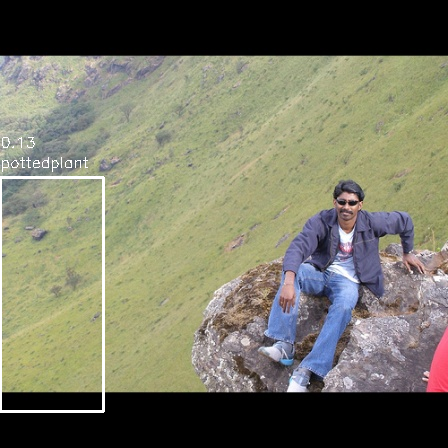

BBox shape: (17, 6)
BBox values: [[3.28245303e-01 0.00000000e+00 9.39461253e-01 3.33905233e-01
  1.07419163e-01 1.10000000e+01]
 [6.72129789e-01 0.00000000e+00 1.00000000e+00 3.46906951e-01
  1.15259394e-01 1.20000000e+01]
 [1.29289110e-01 0.00000000e+00 5.85134138e-01 4.57737901e-01
  1.12214312e-01 2.00000000e+00]
 [5.09039415e-01 8.40884447e-03 1.00000000e+00 4.23739612e-01
  1.26390308e-01 1.60000000e+01]
 [6.17940430e-01 0.00000000e+00 1.00000000e+00 4.32839300e-01
  1.21335089e-01 1.30000000e+01]
 [6.05034573e-02 1.00971886e-01 6.05890427e-01 6.08020672e-01
  1.08171746e-01 3.00000000e+00]
 [2.11459041e-01 1.30111130e-01 7.82054603e-01 6.18041160e-01
  1.16544299e-01 4.00000000e+00]
 [6.62402013e-01 1.34011179e-01 1.00000000e+00 5.99209040e-01
  1.12313919e-01 1.90000000e+01]
 [0.00000000e+00 2.05178022e-01 3.27567688e-01 7.66574502e-01
  9.82597172e-02 1.80000000e+01]
 [0.00000000e+00 2.77145277e-01 4.68949676e-01 7.27738779e-01
  9.03021097e-02 8.00000000e+00]
 [1.57723648e-01 

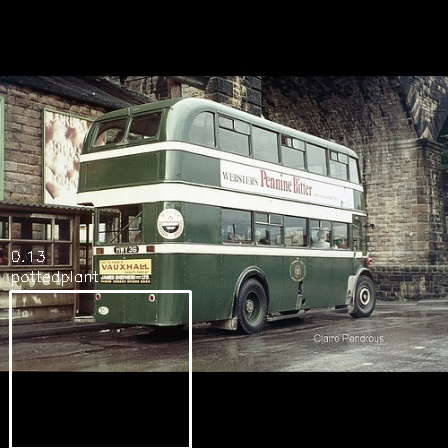

BBox shape: (20, 6)
BBox values: [[ 0.          0.          0.36477435  0.34321672  0.10689917 15.        ]
 [ 0.10486794  0.          0.62203074  0.34759745  0.09256919  6.        ]
 [ 0.34741486  0.          0.92926605  0.28557983  0.10514311 11.        ]
 [ 0.          0.14157359  0.43884626  0.59822843  0.11351869 12.        ]
 [ 0.43313     0.08042659  0.89689395  0.60692026  0.0944589  14.        ]
 [ 0.57278633  0.06458598  1.          0.6900416   0.09559934  2.        ]
 [ 0.64444661  0.11474864  1.          0.61265878  0.09612875 19.        ]
 [ 0.          0.24366641  0.28212957  0.75432109  0.11118866 18.        ]
 [ 0.          0.28148382  0.48480176  0.73696916  0.08752221  8.        ]
 [ 0.          0.36593318  0.46200678  0.92725486  0.08242122  1.        ]
 [ 0.51852609  0.40488451  1.          0.8715215   0.10942464 16.        ]
 [ 0.65998325  0.40358211  1.          0.88193552  0.10208847  7.        ]
 [ 0.          0.54998473  0.25449366  1.          0.09501781 13.  

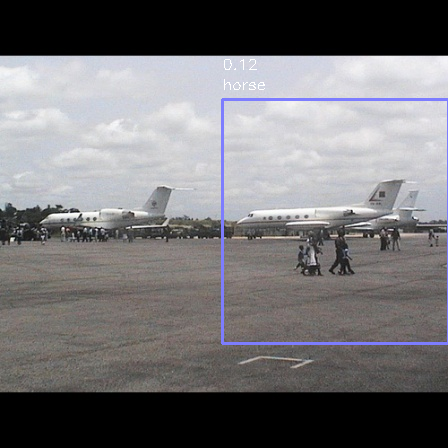

BBox shape: (18, 6)
BBox values: [[3.32650815e-01 0.00000000e+00 9.25477539e-01 3.40850396e-01
  1.09971382e-01 1.10000000e+01]
 [5.01497767e-01 0.00000000e+00 1.00000000e+00 3.02477943e-01
  1.08428396e-01 3.00000000e+00]
 [0.00000000e+00 0.00000000e+00 5.19359082e-01 4.66178373e-01
  9.89792645e-02 1.80000000e+01]
 [3.37956458e-01 0.00000000e+00 9.68632787e-01 4.55850041e-01
  9.83915254e-02 1.70000000e+01]
 [5.00495702e-01 5.04792375e-03 1.00000000e+00 4.35134983e-01
  1.02209933e-01 1.60000000e+01]
 [0.00000000e+00 1.19148465e-01 3.04247413e-01 6.04102792e-01
  1.01655856e-01 2.00000000e+00]
 [2.01481840e-01 1.18088015e-01 8.03798280e-01 6.29401692e-01
  1.01750582e-01 4.00000000e+00]
 [4.13491624e-01 9.24341423e-02 8.99736660e-01 6.03998218e-01
  1.10254250e-01 1.40000000e+01]
 [0.00000000e+00 2.59503343e-01 4.62269038e-01 7.23881879e-01
  9.30624679e-02 8.00000000e+00]
 [4.97587379e-01 2.22716783e-01 1.00000000e+00 7.66373132e-01
  1.22291215e-01 5.00000000e+00]
 [0.00000000e+00 

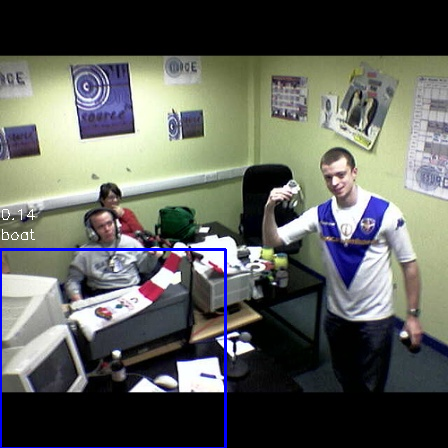

BBox shape: (17, 6)
BBox values: [[7.07014124e-01 0.00000000e+00 1.00000000e+00 3.62699917e-01
  1.00922488e-01 4.00000000e+00]
 [0.00000000e+00 0.00000000e+00 4.94827654e-01 5.11031530e-01
  1.00414895e-01 1.80000000e+01]
 [4.94944062e-01 1.39366942e-02 1.00000000e+00 4.14045508e-01
  1.08285449e-01 1.60000000e+01]
 [6.35958612e-02 1.10288535e-01 6.33636743e-01 5.87580775e-01
  1.11260913e-01 3.00000000e+00]
 [6.73826652e-01 8.49554326e-02 1.00000000e+00 6.37628236e-01
  1.15154885e-01 1.40000000e+01]
 [4.05803504e-01 2.57942936e-01 8.68696900e-01 7.61586866e-01
  1.27736732e-01 1.70000000e+01]
 [5.21297851e-01 2.32211100e-01 1.00000000e+00 7.90454434e-01
  1.11560486e-01 1.00000000e+01]
 [0.00000000e+00 3.88461390e-01 4.58857715e-01 9.20515158e-01
  9.40552652e-02 1.00000000e+00]
 [1.45023951e-01 4.12754687e-01 5.53176829e-01 8.69760158e-01
  8.93956423e-02 1.20000000e+01]
 [2.63529822e-01 3.70593590e-01 7.25529924e-01 9.36655683e-01
  1.04382381e-01 1.50000000e+01]
 [3.35134098e-01 

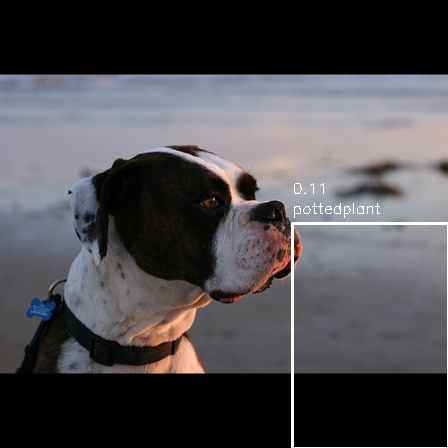

BBox shape: (20, 6)
BBox values: [[ 0.          0.          0.35459943  0.35082815  0.10340882  9.        ]
 [ 0.11227499  0.          0.60782201  0.34286188  0.09159282  6.        ]
 [ 0.27691913  0.          0.72653937  0.38807378  0.09024546  0.        ]
 [ 0.49610264  0.          1.          0.29332802  0.08947502  3.        ]
 [ 0.73326484  0.          1.          0.3596811   0.10324024 12.        ]
 [ 0.          0.          0.28812042  0.46301816  0.0931164   1.        ]
 [ 0.          0.          0.50748714  0.45002814  0.09921293  7.        ]
 [ 0.24993295  0.02759742  0.75853074  0.4281781   0.09628728 15.        ]
 [ 0.          0.14261857  0.44716256  0.58476347  0.10285833  2.        ]
 [ 0.07088693  0.13958289  0.60437329  0.57076826  0.09563497 19.        ]
 [ 0.          0.21476408  0.30062859  0.78894313  0.09024855 18.        ]
 [ 0.39637009  0.29144381  0.91297839  0.67213846  0.10978456 16.        ]
 [ 0.51115397  0.21971845  1.          0.7488833   0.10189407 13.  

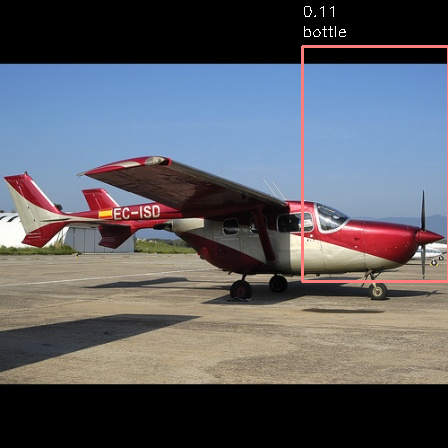

BBox shape: (19, 6)
BBox values: [[ 0.          0.          0.41483599  0.359492    0.09610321 13.        ]
 [ 0.11267423  0.          0.60619055  0.32525811  0.08931032 11.        ]
 [ 0.21769255  0.          0.80480325  0.32895046  0.10104467  0.        ]
 [ 0.          0.          0.29730485  0.41864533  0.09888238 12.        ]
 [ 0.          0.          0.44835493  0.51623668  0.09188467 18.        ]
 [ 0.36451086  0.          0.94819632  0.44768668  0.09822427  5.        ]
 [ 0.61841066  0.          1.          0.43491035  0.09971185  7.        ]
 [ 0.          0.14628144  0.43111108  0.58155231  0.10361017  4.        ]
 [ 0.5730026   0.04534067  1.          0.71197118  0.10038541  2.        ]
 [ 0.67456207  0.10355295  1.          0.62729306  0.1105772  14.        ]
 [ 0.06895796  0.2292299   0.64784101  0.77580157  0.08215546  8.        ]
 [ 0.39455587  0.25353333  0.90338374  0.70899739  0.09817906 16.        ]
 [ 0.          0.38742558  0.47480031  0.89903013  0.09731112  1.  

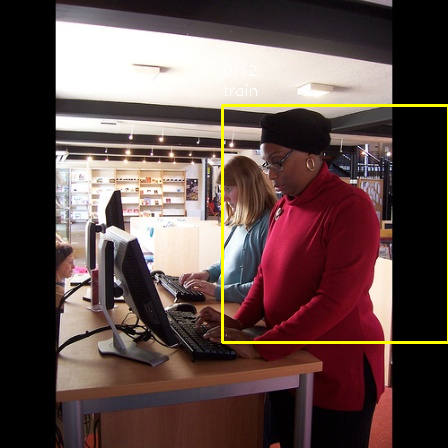

BBox shape: (17, 6)
BBox values: [[ 0.38351419  0.          0.89205506  0.30818881  0.09029458 11.        ]
 [ 0.64859493  0.          1.          0.36418214  0.0890795  12.        ]
 [ 0.40604185  0.          0.9139558   0.51403541  0.08823478 17.        ]
 [ 0.          0.11007259  0.47063463  0.61296353  0.1008986   2.        ]
 [ 0.18224633  0.12280606  0.80631167  0.62137186  0.0990978   4.        ]
 [ 0.41933336  0.04217335  0.90519627  0.6948944   0.1149337  14.        ]
 [ 0.          0.20937871  0.32176771  0.7842344   0.09585933  7.        ]
 [ 0.39935607  0.30726412  0.90557057  0.66554465  0.11164385 16.        ]
 [ 0.49682329  0.23475299  1.          0.76481095  0.12150604 13.        ]
 [ 0.          0.43507643  0.34876154  0.88420336  0.10149598  1.        ]
 [ 0.          0.39151136  0.5132599   0.90846232  0.10595223 19.        ]
 [ 0.28328958  0.38741481  0.69799492  0.89565152  0.09511392 15.        ]
 [ 0.66213436  0.36868453  1.          0.97304547  0.09506713  0.  

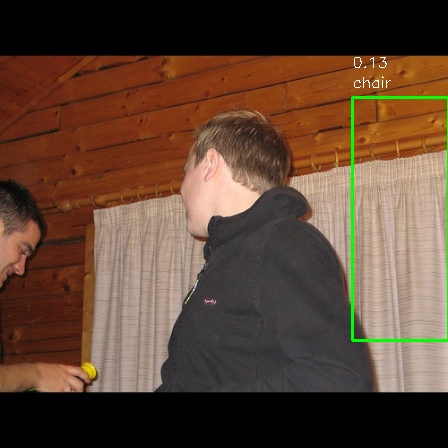

BBox shape: (19, 6)
BBox values: [[ 0.          0.          0.43035353  0.35593058  0.11079087 17.        ]
 [ 0.08799322  0.          0.61107047  0.35312088  0.12399942  6.        ]
 [ 0.38120509  0.          0.89078093  0.33271021  0.09655996 11.        ]
 [ 0.          0.          0.49983911  0.49011141  0.10494491 10.        ]
 [ 0.64091726  0.          1.          0.43034675  0.11544043  7.        ]
 [ 0.          0.153719    0.48318711  0.58341091  0.12586103  4.        ]
 [ 0.1052902   0.13044593  0.61579248  0.58043885  0.08574191  3.        ]
 [ 0.40894322  0.02394604  0.89260815  0.69518894  0.1015765  14.        ]
 [ 0.53895032  0.07082165  1.          0.6762293   0.11242145  2.        ]
 [ 0.          0.25809437  0.29435183  0.72503886  0.09662136 18.        ]
 [ 0.          0.25451753  0.48152495  0.75953487  0.0909412   8.        ]
 [ 0.27994579  0.27594541  0.73173895  0.71240725  0.11592475  5.        ]
 [ 0.78731352  0.2174093   1.          0.75944237  0.13052332 15.  

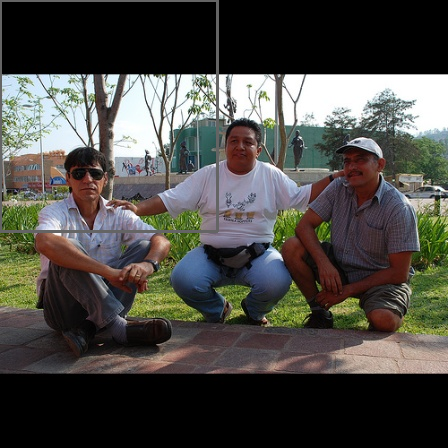

BBox shape: (19, 6)
BBox values: [[ 0.11598468  0.          0.60727412  0.32763601  0.10727555 11.        ]
 [ 0.70301916  0.          1.          0.34704397  0.11572077 12.        ]
 [ 0.          0.          0.26276679  0.44729209  0.10204475  9.        ]
 [ 0.          0.          0.48479654  0.51684025  0.12778559 18.        ]
 [ 0.          0.14023506  0.44708084  0.60066005  0.11410432  2.        ]
 [ 0.06339449  0.11958206  0.61357731  0.58773229  0.09080428  3.        ]
 [ 0.17612119  0.11491343  0.81193228  0.61448874  0.08516248  4.        ]
 [ 0.40491503  0.04790894  0.90933079  0.70297459  0.1138179  14.        ]
 [ 0.          0.3018895   0.49734695  0.70557927  0.08025014  8.        ]
 [ 0.16011055  0.18939629  0.56716373  0.78143504  0.10824514  7.        ]
 [ 0.          0.40206678  0.21870237  0.92836667  0.11222398 17.        ]
 [ 0.          0.42026143  0.4780733   0.89034187  0.11783751 19.        ]
 [ 0.33594852  0.34901249  0.95594692  0.92675536  0.10964336  6.  

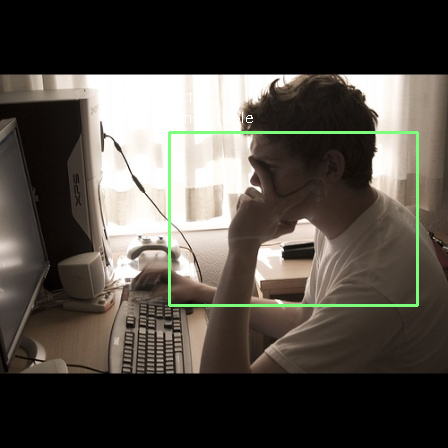

BBox shape: (19, 6)
BBox values: [[0.00000000e+00 0.00000000e+00 4.20978940e-01 3.77398925e-01
  9.96707156e-02 1.80000000e+01]
 [1.00356268e-01 0.00000000e+00 6.15020620e-01 3.29272198e-01
  1.09308444e-01 1.10000000e+01]
 [3.33017741e-01 0.00000000e+00 9.32289813e-01 3.40897309e-01
  8.93735588e-02 8.00000000e+00]
 [0.00000000e+00 0.00000000e+00 4.91986773e-01 4.67387634e-01
  9.99725536e-02 7.00000000e+00]
 [0.00000000e+00 1.41547978e-01 4.96661689e-01 5.87473333e-01
  1.17078565e-01 2.00000000e+00]
 [3.78705123e-01 2.95741154e-01 9.32566085e-01 6.81893063e-01
  1.26480326e-01 1.60000000e+01]
 [5.21780785e-01 2.27848692e-01 1.00000000e+00 7.81587643e-01
  9.82021019e-02 1.00000000e+01]
 [7.29958860e-01 2.07151413e-01 1.00000000e+00 7.80839741e-01
  1.04441039e-01 1.50000000e+01]
 [0.00000000e+00 3.84878725e-01 4.34734583e-01 9.23191220e-01
  1.13029987e-01 1.00000000e+00]
 [1.50272989e-01 3.81724702e-01 5.49409383e-01 8.92787444e-01
  1.26038164e-01 1.20000000e+01]
 [2.62151290e-01 

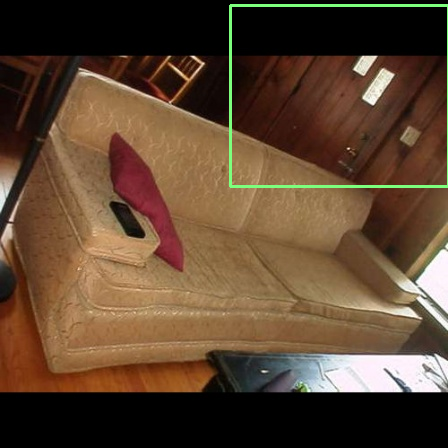

BBox shape: (19, 6)
BBox values: [[0.00000000e+00 0.00000000e+00 3.44186021e-01 3.10012187e-01
  1.06783524e-01 1.50000000e+01]
 [0.00000000e+00 0.00000000e+00 4.51038965e-01 3.59748576e-01
  1.22299477e-01 1.70000000e+01]
 [3.64924861e-01 0.00000000e+00 9.01357485e-01 3.49462266e-01
  9.86483768e-02 1.10000000e+01]
 [4.95290467e-01 0.00000000e+00 1.00000000e+00 3.17401226e-01
  1.26137689e-01 1.80000000e+01]
 [0.00000000e+00 0.00000000e+00 4.84830869e-01 4.93908499e-01
  1.36157542e-01 1.00000000e+01]
 [5.14883693e-01 1.27481605e-02 1.00000000e+00 4.15798643e-01
  1.40458420e-01 1.60000000e+01]
 [0.00000000e+00 1.26599780e-01 3.21648538e-01 6.08126751e-01
  1.04914255e-01 2.00000000e+00]
 [0.00000000e+00 1.42807158e-01 4.74259887e-01 5.85462572e-01
  1.34373933e-01 1.20000000e+01]
 [6.56616569e-01 1.19304691e-01 1.00000000e+00 6.08599101e-01
  1.38595045e-01 1.40000000e+01]
 [2.46120108e-01 2.76730095e-01 7.51296056e-01 7.11467062e-01
  1.15463629e-01 8.00000000e+00]
 [5.06016940e-01 

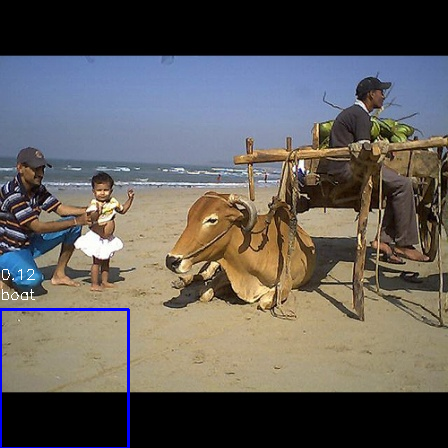

BBox shape: (17, 6)
BBox values: [[4.25236566e-03 0.00000000e+00 3.95806304e-01 3.64065851e-01
  1.08676299e-01 1.70000000e+01]
 [9.60561718e-02 0.00000000e+00 6.20050856e-01 3.53394006e-01
  9.89886969e-02 1.10000000e+01]
 [6.76783411e-01 0.00000000e+00 1.00000000e+00 3.85605799e-01
  1.17111750e-01 1.20000000e+01]
 [0.00000000e+00 0.00000000e+00 4.67772646e-01 5.12611287e-01
  1.02704078e-01 1.30000000e+01]
 [5.08572791e-01 0.00000000e+00 1.00000000e+00 4.16448866e-01
  1.14286460e-01 1.60000000e+01]
 [0.00000000e+00 1.16815563e-01 4.64567763e-01 6.11906107e-01
  1.11855336e-01 4.00000000e+00]
 [5.61532617e-01 5.81669084e-02 1.00000000e+00 6.76879989e-01
  1.20989129e-01 2.00000000e+00]
 [6.63994972e-01 1.07144454e-01 1.00000000e+00 6.11844220e-01
  1.12485461e-01 1.40000000e+01]
 [0.00000000e+00 2.73014309e-01 5.20791428e-01 7.39088806e-01
  9.09534916e-02 6.00000000e+00]
 [9.03000150e-02 2.23294531e-01 6.39508895e-01 7.78080140e-01
  9.22607481e-02 7.00000000e+00]
 [2.45666721e-01 

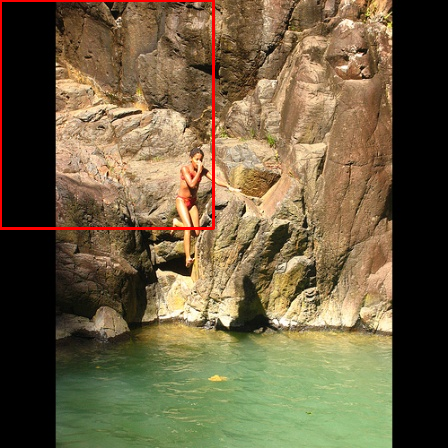

BBox shape: (20, 6)
BBox values: [[0.00000000e+00 0.00000000e+00 3.41563634e-01 3.15358700e-01
  1.18270434e-01 1.50000000e+01]
 [7.17849817e-03 0.00000000e+00 4.31940568e-01 3.41668738e-01
  1.24728009e-01 1.80000000e+01]
 [2.49840298e-01 0.00000000e+00 7.58598068e-01 3.52605637e-01
  1.05305739e-01 0.00000000e+00]
 [3.47344645e-01 0.00000000e+00 9.25239452e-01 3.24839179e-01
  1.02197602e-01 1.10000000e+01]
 [6.54901211e-01 0.00000000e+00 1.00000000e+00 4.01465195e-01
  1.25048399e-01 1.20000000e+01]
 [0.00000000e+00 0.00000000e+00 4.75751443e-01 5.10882463e-01
  1.28833264e-01 1.00000000e+01]
 [3.59025385e-01 0.00000000e+00 9.39602877e-01 4.37244311e-01
  9.85379592e-02 1.70000000e+01]
 [6.08409026e-01 0.00000000e+00 1.00000000e+00 4.26831458e-01
  1.04754657e-01 7.00000000e+00]
 [1.94760135e-01 1.08621938e-01 7.89418093e-01 6.13844020e-01
  1.21845894e-01 4.00000000e+00]
 [7.11404255e-01 1.43839025e-01 1.00000000e+00 5.86803549e-01
  1.12740092e-01 1.90000000e+01]
 [0.00000000e+00 

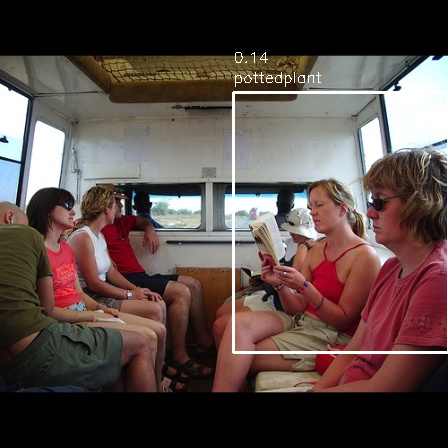

BBox shape: (20, 6)
BBox values: [[ 0.          0.          0.42193233  0.38316621  0.11046809  2.        ]
 [ 0.36067195  0.          0.90232629  0.32206567  0.12316517 11.        ]
 [ 0.70638411  0.          1.          0.36112636  0.11598666 12.        ]
 [ 0.          0.          0.53327027  0.46446743  0.10233429 10.        ]
 [ 0.71426362  0.          1.          0.51290685  0.10251194  7.        ]
 [ 0.          0.13464069  0.48154257  0.58595526  0.1141384   4.        ]
 [ 0.11106477  0.0761588   0.61950741  0.61866097  0.08968563  3.        ]
 [ 0.          0.22447479  0.32477464  0.76032919  0.09534412 18.        ]
 [ 0.          0.28922856  0.48302085  0.73345313  0.09319808  8.        ]
 [ 0.52071788  0.20754493  1.          0.78612549  0.13722399 17.        ]
 [ 0.74052284  0.23074615  1.          0.76022589  0.11158115 14.        ]
 [ 0.          0.38760147  0.22209299  0.9417319   0.11288806  1.        ]
 [ 0.          0.36761462  0.4914294   0.926957    0.12372678 19.  

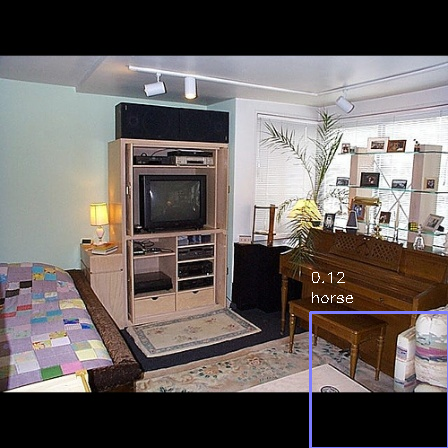

BBox shape: (19, 6)
BBox values: [[ 0.          0.          0.44077813  0.35059828  0.10203747 17.        ]
 [ 0.72598089  0.          1.          0.35376371  0.10614832  3.        ]
 [ 0.          0.          0.4893391   0.51723347  0.0925788  10.        ]
 [ 0.65963346  0.          1.          0.43276609  0.0969132   7.        ]
 [ 0.          0.11939523  0.43446611  0.60814587  0.10221643  4.        ]
 [ 0.21112784  0.12610318  0.78713318  0.61855226  0.10107321 11.        ]
 [ 0.43686795  0.06920022  0.87883776  0.61915827  0.10546754 14.        ]
 [ 0.59187328  0.05205374  0.98542081  0.70147317  0.11741617  2.        ]
 [ 0.          0.23084682  0.31533164  0.74677419  0.09459881 18.        ]
 [ 0.          0.28113038  0.47431577  0.72946385  0.0810918   8.        ]
 [ 0.42255161  0.28957455  0.88125149  0.67785923  0.11427075 16.        ]
 [ 0.49801883  0.23335406  1.          0.74693397  0.09309404 13.        ]
 [ 0.73313675  0.24919216  1.          0.72626171  0.10932627 12.  

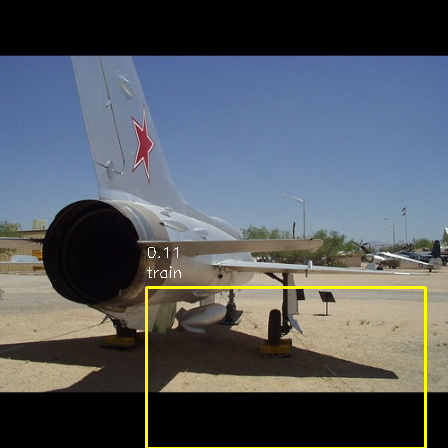

BBox shape: (19, 6)
BBox values: [[ 0.37462308  0.          0.90697773  0.32101462  0.0944474  11.        ]
 [ 0.6485539   0.          1.          0.38768034  0.10329925 12.        ]
 [ 0.          0.          0.46935219  0.51493027  0.09602176 10.        ]
 [ 0.26629147  0.04844689  0.73809329  0.41784039  0.09770829 15.        ]
 [ 0.          0.12878832  0.48609861  0.59884012  0.11144747  4.        ]
 [ 0.07715079  0.11756009  0.59287933  0.60105893  0.09699792  3.        ]
 [ 0.          0.22237873  0.30351368  0.75765473  0.09061848 18.        ]
 [ 0.          0.30769621  0.46763509  0.7092387   0.08996269  8.        ]
 [ 0.09044507  0.22179147  0.64061305  0.76720866  0.09614037  1.        ]
 [ 0.27448074  0.27952244  0.73653469  0.72576483  0.09528188  5.        ]
 [ 0.28608213  0.43009276  0.71225657  0.85844663  0.11367794 14.        ]
 [ 0.32742599  0.35834035  0.9495692   0.91742817  0.09773104  6.        ]
 [ 0.67151091  0.39256283  1.          0.94005808  0.10710287 16.  

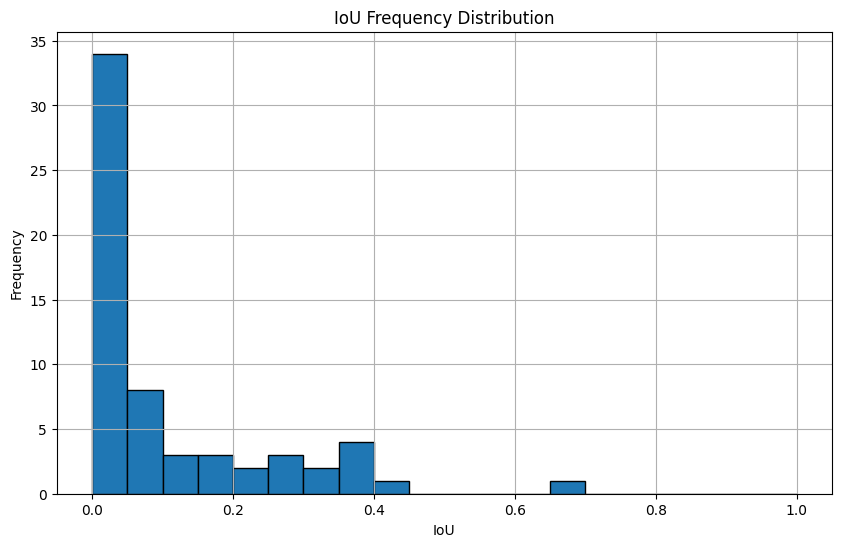

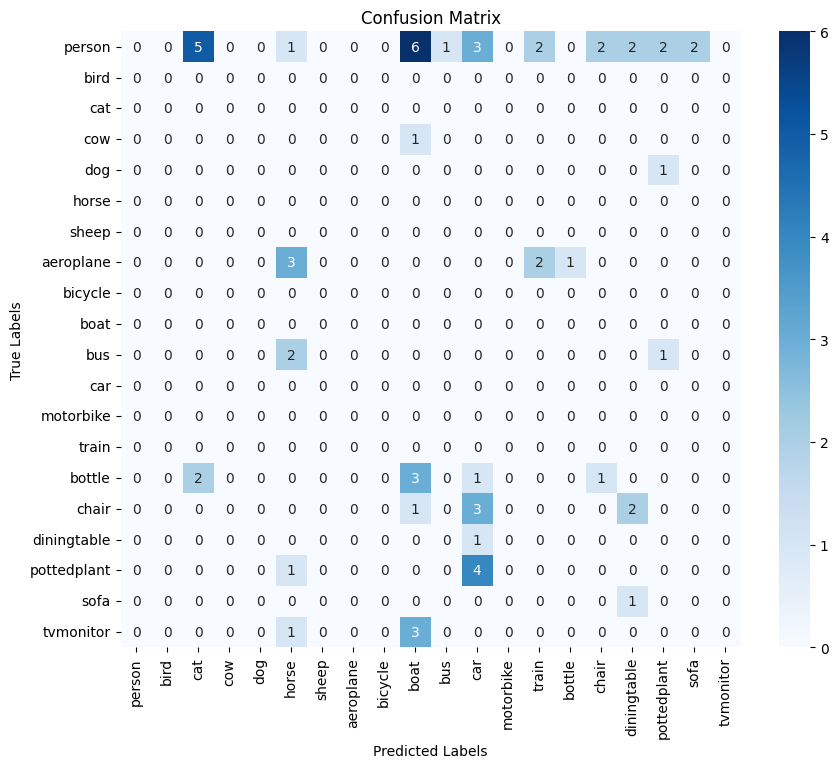

In [ ]:
class TestInterface(object):
    """
    Network Testing Interface
    main(): Main function for network testing
    """
    def __init__(self, opts):
        self.opts = opts
        self.gt_labels = []  # Store ground truth labels
        self.pred_labels = []  # Store predicted labels
        self.iou_list = []  # Store IoU values
        print("=======================Start inferring.=======================")

    def main(self):
        """
        Main testing procedure
        """
        opts = self.opts
        img_list = os.listdir(opts.dataset_dir)
        trans = transforms.Compose([
            transforms.ToTensor(),
        ])
        model = torch.load('/content/checkpoints/epoch20.pkl', weights_only=False)
        if opts.use_GPU:
            model.to(opts.GPU_id)

        # Add a counter to limit processing to 20 images
        count = 0
        max_images = 20

        for img_name in img_list:
            if count >= max_images:  # Stop processing after 20 images
                break

            img_path = os.path.join(opts.dataset_dir, img_name)
            img = Image.open(img_path).convert('RGB')
            img_tensor = trans(img)
            img_tensor = torch.unsqueeze(img_tensor, dim=0)
            print(img_name, img_tensor.shape)

            if opts.use_GPU:
                img_tensor = img_tensor.to(opts.GPU_id)

            # Model inference
            preds = torch.squeeze(model(img_tensor), dim=0).detach().cpu()
            preds = preds.permute(1, 2, 0)
            bbox = labels2bbox(preds)

            # Load the original image
            draw_img = cv2.imread(img_path)
            if draw_img is None:
                print(f"Failed to load image: {img_path}")
                continue

            # Load ground truth bounding box
            xml_path = os.path.join("/content/drive/MyDrive/VOCdevkit/VOC2012/Annotations", img_name.replace(".jpg", ".xml"))
            if not os.path.exists(xml_path):
                print(f"XML file not found: {xml_path}")
                continue
            gt_bboxes = parse_voc_xml(xml_path)

            # Draw bounding boxes and compute IoU
            self.draw_bbox(draw_img, bbox, gt_bboxes)
            print("BBox shape:", bbox.shape)  # Print bbox shape
            print("BBox values:", bbox)  # Print bbox values
            count += 1  # Update counter

        # Plot IoU frequency distribution
        self.plot_iou_frequency()

        # Generate confusion matrix
        self.plot_confusion_matrix()

    def draw_bbox(self, img, bbox, gt_bboxes):
        """
        Draw the bounding box with the highest confidence and calculate IoU
        :param img: Image to draw bbox on
        :param bbox: Shape (n,6), 0:4 are (x1,y1,x2,y2), 4 is confidence, 5 is class
        :param gt_bboxes: List of ground truth bounding boxes
        """
        h, w = img.shape[0:2]
        n = bbox.shape[0]
        print(f"Number of bounding boxes: {n}")  # Print number of bounding boxes
        print("BBox values:", bbox)  # Print bbox values

        if n == 0:  # If no bounding boxes are detected
            print("No bounding boxes detected.")
            cv2_imshow(img)
            return

        # Find the bounding box with the highest confidence
        max_confidence_idx = np.argmax(bbox[:, 4])  # Get index of the highest confidence bbox
        best_bbox = bbox[max_confidence_idx]  # Retrieve the best bounding box

        # Extract bbox coordinates, confidence, and class
        confidence = best_bbox[4]
        if confidence < 0.1:  # Skip if confidence is below the threshold
            print("Best bounding box confidence is below threshold.")
            cv2_imshow(img)
            return

        # Scale coordinates to original image dimensions
        scale_x = w  # Original image width
        scale_y = h  # Original image height
        x1 = int(best_bbox[0] * scale_x)
        y1 = int(best_bbox[1] * scale_y)
        x2 = int(best_bbox[2] * scale_x)
        y2 = int(best_bbox[3] * scale_y)

        # Check if coordinates are within image bounds
        if x1 < 0 or y1 < 0 or x2 > w or y2 > h:
            print(f"Best bounding box is out of image bounds: ({x1}, {y1}) -> ({x2}, {y2})")
            cv2_imshow(img)
            return

        # Validate coordinates
        if x1 >= x2 or y1 >= y2:
            print(f"Invalid bounding box coordinates: ({x1}, {y1}) -> ({x2}, {y2})")
            cv2_imshow(img)
            return

        # Get class name and color
        cls_name = GL_CLASSES[int(best_bbox[5])]
        color = COLOR[int(best_bbox[5])]

        # Print debug information
        print(f"Best bounding box - Class: {cls_name}, Confidence: {confidence}, BBox: ({x1}, {y1}) -> ({x2}, {y2}), Color: {color}")

        # Draw bounding box
        cv2.rectangle(img, (x1, y1), (x2, y2), color, thickness=2)

        # Draw class name and confidence
        cv2.putText(img, cls_name, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1)
        cv2.putText(img, f"{confidence:.2f}", (x1, y1 - 30), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1)

        # Compute IoU and store
        for gt in gt_bboxes:
            gt_bbox = gt['bbox']
            gt_class = gt['class']
            self.gt_labels.append(gt_class)  # Store ground truth labels
            self.pred_labels.append(cls_name)  # Store predicted labels

            # Compute IoU
            pred_bbox = [x1, y1, x2, y2]
            iou = calculate_iou(gt_bbox, pred_bbox)
            self.iou_list.append(iou)  # Store IoU values
            print(f"IoU for GT {gt_bbox} and Pred {pred_bbox}: {iou:.2f}")

        # Show image
        cv2_imshow(img)

    def plot_iou_frequency(self):
        """
        Plot IoU frequency distribution
        """
        plt.figure(figsize=(10, 6))
        plt.hist(self.iou_list, bins=20, range=(0, 1), edgecolor='black')
        plt.title('IoU Frequency Distribution')
        plt.xlabel('IoU')
        plt.ylabel('Frequency')
        plt.grid(True)
        plt.show()

    def plot_confusion_matrix(self):
        """
        Plot confusion matrix
        """
        cm = confusion_matrix(self.gt_labels, self.pred_labels, labels=GL_CLASSES)
        plt.figure(figsize=(10, 8))
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=GL_CLASSES, yticklabels=GL_CLASSES)
        plt.title('Confusion Matrix')
        plt.xlabel('Predicted Labels')
        plt.ylabel('True Labels')
        plt.show()

if __name__ == '__main__':
    args = Args()
    args.set_test_args()
    test_interface = TestInterface(args.get_opts())
    test_interface.main()
